Debería de ponerla a trabajar de nuevo ya que tenía un error: quitaba la imagen 2 en vez de la 12

# Libraries

In [4]:
'''Main'''
import numpy as np
import pandas as pd
import os, time, re
import pickle, gzip
from random import randint
import math
import re

'''Data Viz'''
import matplotlib.pyplot as plt
from matplotlib.pyplot import hist
import matplotlib.cm as cm
import seaborn as sns
color = sns.color_palette()
import matplotlib as mpl

%matplotlib inline

'''Data Prep and Model Evaluation'''
from sklearn import preprocessing as pp
from sklearn.metrics import mean_squared_error
from sklearn.cluster import KMeans
from sklearn.neighbors import NearestNeighbors
from sklearn.model_selection import train_test_split 
from sklearn.model_selection import StratifiedKFold 
from sklearn.metrics import log_loss
from sklearn.metrics import precision_recall_curve, average_precision_score
from sklearn.metrics import roc_curve, auc, roc_auc_score
import joblib 

'''Algos'''
#import lightgbm as lgb

'''TensorFlow and Keras'''
import tensorflow as tf
import keras
from keras import backend as K
from keras.models import Sequential, Model, load_model
from keras.layers import Activation, Dense, Dropout
from keras.layers import BatchNormalization, Input, Lambda
from keras import regularizers
from keras.losses import mse, binary_crossentropy

from osgeo import gdal
from osgeo import gdal_array
import matplotlib.pyplot as plt
import numpy as np
import sys
from osgeo.gdalconst import *
import os

import math
import codecs

import osgeo #this is necessary for the type comparison in some methods
from osgeo import osr
from osgeo import ogr
from collections import defaultdict
import itertools
from osgeo import gdal_array as gdar
from osgeo import gdalconst as gdct
import glob

# Inputs

In [5]:
path_images = '/Users/clara/Projects/A4_Cube/Images/Strobler/'
bands = ['Cloud','B1', 'B2', 'B3', 'B4', 'B5', 'B6', 'B7', 'B8', 'B8A', 'B9', 'B10', 'B11', 'B12']
model_filepath = '/Users/clara/Projects/A4_Cube/Codes/Strobler/correcData/Models/'
figures_filepath = '/Users/clara/Projects/A4_Cube/Codes/Strobler/correcData/Figures/'
n_pixels = 1
n_clusters = 8

# Data from .tif images

**UPLOAD TIFF AND CUSTOMIZE ARRAY**

In [6]:
def is_leap_year(year):
    """ if year is a leap year return True
        else return False """
    if year % 100 == 0:
        return year % 400 == 0
    return year % 4 == 0

def doy(Y,M,D):
    """ given year, month, day return day of year
        Astronomical Algorithms, Jean Meeus, 2d ed, 1998, chap 7 """
    if is_leap_year(Y):
        K = 1
    else:
        K = 2
    N = int((275 * M) / 9.0) - K * int((M + 9) / 12.0) + D - 30
    return N

**Train**

In [9]:
#Train
trainArray = []
ymds = []
doys = []

files = sorted(os.listdir(path_images))
for f in files:
    if not f.startswith(('.', 'm')) and f.endswith(('.tif')) and os.path.isfile(os.path.join(path_images, f)):
        # Bands
        tif = gdal_array.LoadFile(path_images+f)
        tif = np.delete(tif, 0, axis=0)
        tif = np.delete(tif, 10, axis=0)
        tif = tif/6000
        
        # DOY: t1, t2
        Y_M_D = re.sub("[^0-9]", "", f)
        ymds.append(Y_M_D)
        d = doy(int(Y_M_D[-4:]),int(Y_M_D[2:4]),int(Y_M_D[:2]))
        doys.append(d)
        t1 = np.full((tif.shape[1], tif.shape[2]), (np.sin(d*2*np.pi/365)+1)/2)
        t2 = np.full((tif.shape[1], tif.shape[2]), (np.cos(d*2*np.pi/365)+1)/2)
        t1_t2 = np.stack([t1, t2], axis=0)
        
        # Join
        tif = np.concatenate([tif, t1_t2], axis=0)
        print(tif.shape)
        trainArray.append(tif)

trainArray = np.stack(trainArray, axis = 0)

print(f'''-> Files:
{files}''')
print(f'-> Dates: {ymds}')
print(f'-> DOYs: {doys}')
print(f'-> tifArray shape: {trainArray.shape}')

(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
-> Files:
['.DS_Store', 'Strobbler_clean_Image_01042017.tif', 'Strobbler_clean_Image_01042017.tif.aux.xml', 'Strobbler_clean_Image_02082017.tif', 'Strobbler_clean_Image_02082017.tif.aux.xml', 'Strobbler_clean_Image_04082018.tif', 'Strobbler_clean_Image_04082018.tif.aux.xml', 'Strobbler_clean_Image_05072017.ti

**Test**

In [10]:
#ATENCIÓN:
#Test (tiene diferente shape por eso lo hago a parte, de normal las cargaría todas juntas y después dividiría train y test)

# Bands
tif = gdal_array.LoadFile('/Users/clara/Projects/A4_Cube/Images/Strobler/Test/Strobbler_clean_Image_27082019.tif')
tif = np.delete(tif, 0, axis=0)
tif = np.delete(tif, 10, axis=0)
tif = tif/6000

# DOY: t1, t2
Y_M_D = '27082019'
d = doy(int(Y_M_D[-4:]),int(Y_M_D[2:4]),int(Y_M_D[:2]))
print(f'DOY: {d}')
t1 = np.full((tif.shape[1], tif.shape[2]), (np.sin(d*2*np.pi/365)+1)/2)
t2 = np.full((tif.shape[1], tif.shape[2]), (np.cos(d*2*np.pi/365)+1)/2)
t1_t2 = np.stack([t1, t2], axis=0)

# Join
testArray = np.concatenate([tif, t1_t2], axis=0)
testArray.shape

DOY: 239


(14, 193, 354)

**Bands**

In [11]:
bands = ['B1', 'B2', 'B3', 'B4', 'B5', 'B6', 'B7', 'B8', 'B8A', 'B9', 'B11', 'B12', 't1', 't2']

# True color composite

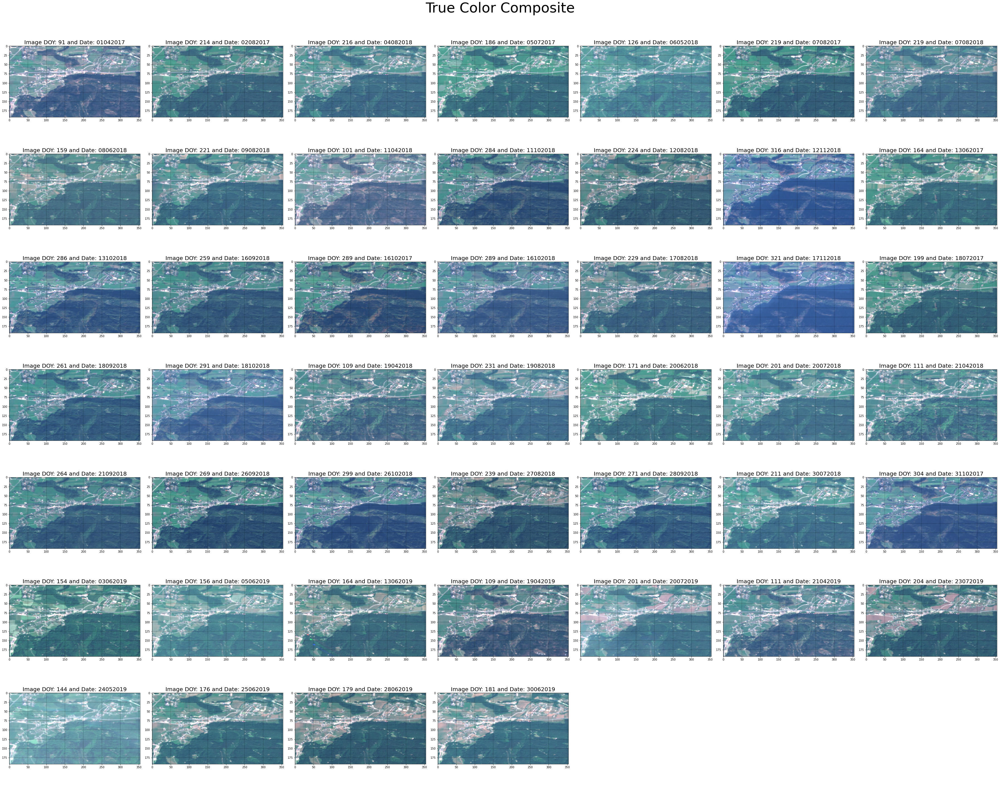

In [7]:
# Fill in number of figures:
n_figures = trainArray.shape[0]

# Prepare subplots
n_rows = int(math.ceil((n_figures)**(1/2)))
n_cols = int(math.ceil(n_figures/n_rows))
rows=[]
columns = []
for row in range(n_rows):
    for col in range(n_cols):
        rows.append(row)
        columns.append(col)

# Subplots and figure title
fig, axs = plt.subplots(n_rows, n_cols, figsize= (50,40))
fig.suptitle(f'True Color Composite', fontsize = 50)

# Plot images
for sp in range(n_figures):
    image = trainArray[sp]
    img = np.dstack((image[3, ...]*4, image[2, ...]*4, image[1, ...]*4))
    img = np.clip(img, 0, 1)
    ax = axs[rows[sp], columns[sp]]
    img = ax.imshow(np.array(img))
    ax.grid(color='black', linewidth=0.3)
    ax.set_title(f'Image DOY: {doys[sp]} and Date: {ymds[sp]}', fontsize=20)

# delete empty figures
for image in range(n_figures, n_rows*n_cols):
    axs[rows[image], columns[image]].set_axis_off()

# save
plt.tight_layout()
fig.subplots_adjust(top=0.95)
plt.savefig(f'{figures_filepath}/original_images.png', format='png', dpi=300)
plt.show()

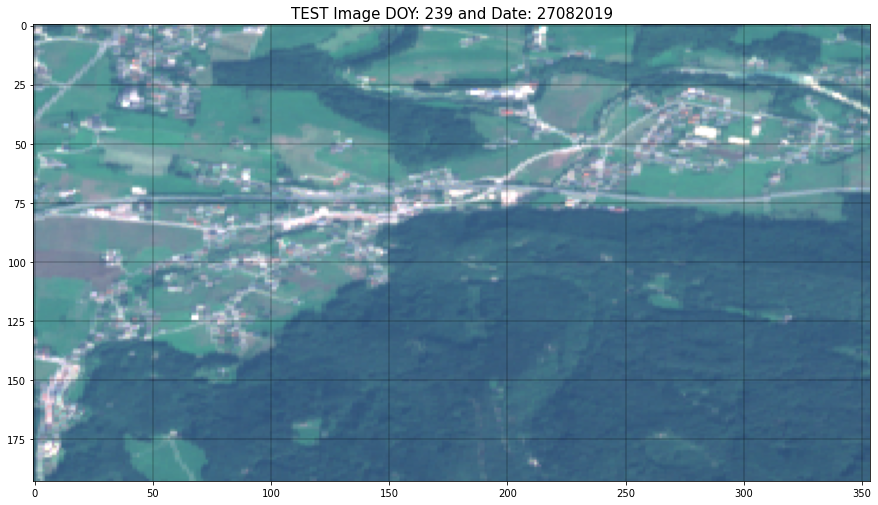

In [8]:
plt.figure(figsize = (15,15))
image = testArray
img = np.dstack((image[3, ...]*4, image[2, ...]*4, image[1, ...]*4))
img = np.clip(img, 0, 1)
plt.imshow(np.array(img))
plt.grid(color='black', linewidth=0.3)
plt.title(f'TEST Image DOY: {d} and Date: {Y_M_D}', fontsize=15)
plt.savefig(f'{figures_filepath}/original_images_flood.png', format='png', dpi=300)
plt.show()

Flood Mask shape: (191, 352)


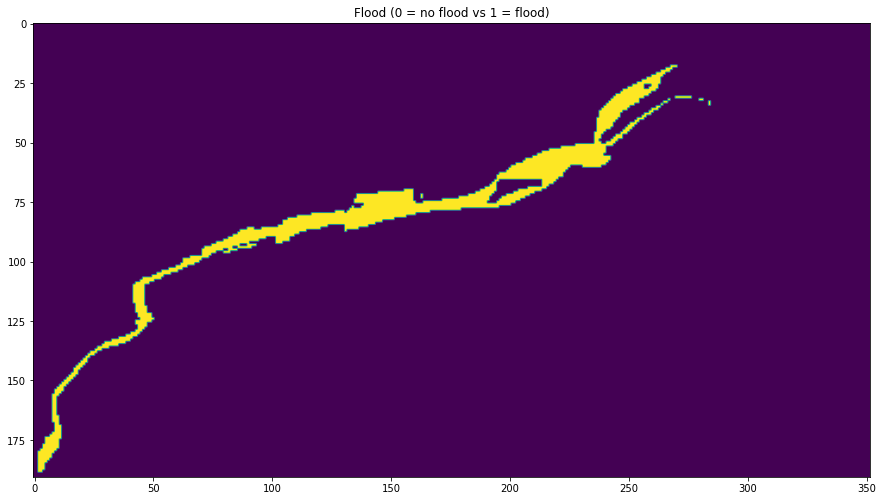

In [9]:
files = sorted(os.listdir(path_images))
for f in files:
    if not f.startswith(('.','Strobler', 'Test')) and os.path.isfile(os.path.join(path_images, f)):
        # Labels
        flood = gdal_array.LoadFile(path_images+f)
print(f'Flood Mask shape: {flood.shape}')
plt.figure(figsize = (15,15))
plt.title ('Flood (0 = no flood vs 1 = flood)')
plt.savefig(f'{figures_filepath}/flood_mask.png', format='png', dpi=300)
plt.imshow(flood)

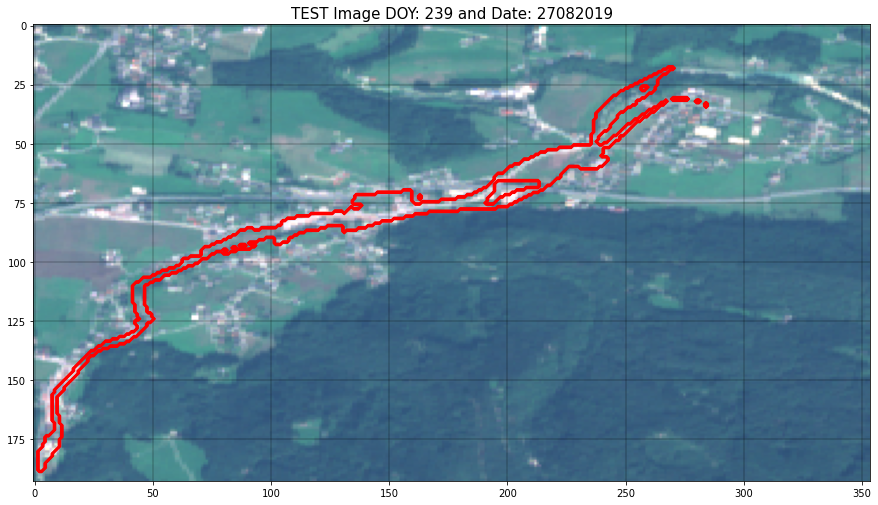

In [10]:
plt.figure(figsize = (15,15))
image = testArray
img = np.dstack((image[3, ...]*4, image[2, ...]*4, image[1, ...]*4))
img = np.clip(img, 0, 1)
plt.imshow(np.array(img))
plt.contour(flood==1, colors='red', linewidths=1.5)
plt.grid(color='black', linewidth=0.3)
plt.title(f'TEST Image DOY: {d} and Date: {Y_M_D}', fontsize=15)
plt.savefig(f'{figures_filepath}/original_images_floodBound.png', format='png', dpi=300)
plt.show()

# Image selection

In [14]:
# Delete images
img_cloud = [4, 12, 17, 19, 22, 30, 34, 36, 42]
trainArray = np.delete(trainArray, img_cloud, axis=0)
shape=trainArray.shape
print(f'shape: {shape}')

shape: (37, 14, 193, 354)


In [75]:
doys = list(np.delete(np.array(doys), img_cloud, axis = 0))
len(doys)

IndexError: index 42 is out of bounds for axis 0 with size 37

# Prepare data for AE and Clustering

**CLUSTERING**

In [43]:
array_kmeans = trainArray[:,:-2, :,:]
array_kmeans = np.transpose(array_kmeans.reshape(array_kmeans.shape[0]*array_kmeans.shape[1], array_kmeans.shape[2]*array_kmeans.shape[3]))
array_kmeans.shape

(68322, 444)

**PREDICT TRAINING**

In [44]:
# Reshape: images, bands, rows*columns
TRAINarray_ae = trainArray.reshape(trainArray.shape[0], trainArray.shape[1], trainArray.shape[2]*trainArray.shape[3])
# Join per images: bands, images*rows*columns
TRAINarray_ae = np.concatenate(TRAINarray_ae, axis=1)
# Transpose: images*rows*columns, bands
TRAINarray_ae = TRAINarray_ae.transpose()
TRAINarray_ae.shape

(2527914, 14)

**PREDICT TESTING**

In [45]:
# Reshape: images, bands, rows*columns
array_ae = testArray.reshape(testArray.shape[0], testArray.shape[1]*testArray.shape[2])
# Transpose: images*rows*columns, bands
array_ae = array_ae.transpose()
array_ae.shape

(68322, 14)

# Clustering

In [46]:
# Train K-means
n_features = array_kmeans.shape[1]
print('Training the algorithm...')
start = time.time()
means = KMeans(n_clusters=n_clusters, n_init = 20, random_state = 1996).fit(array_kmeans)
end = time.time()
print(f'--- minutes ---- {(end - start)/60}')

Training the algorithm...
--- minutes ---- 0.7993725339571635


In [47]:
labels = means.labels_.reshape(trainArray.shape[2], trainArray.shape[3])

<Figure size 432x288 with 0 Axes>

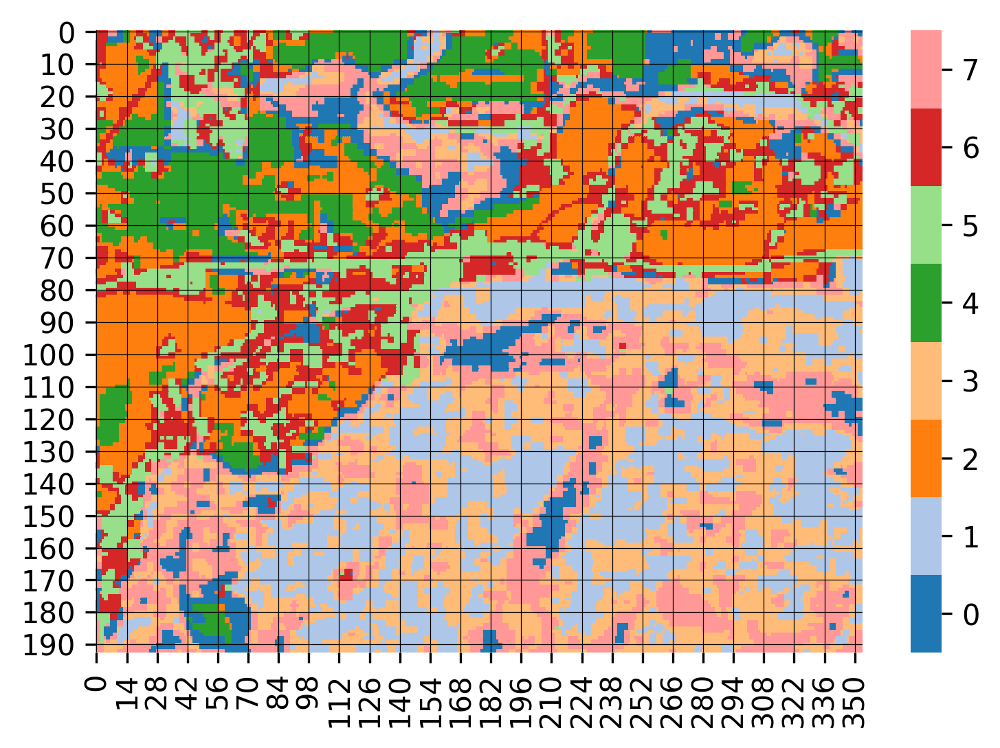

In [48]:
plt.figure()
# discrete colormap (n samples from a given cmap)
cmap = sns.color_palette('tab20', n_clusters) 
fig, ax = plt.subplots(dpi=300) 
ax = sns.heatmap(labels, cmap=cmap) 
# modify colorbar:
colorbar = ax.collections[0].colorbar 
r = colorbar.vmax - colorbar.vmin 
colorbar.set_ticks([colorbar.vmin + r / n_clusters * (0.5 + i) for i in range(n_clusters)])
colorbar.set_ticklabels(list(range(n_clusters)))
plt.grid(color='black', linewidth=0.3)
plt.savefig(f'{figures_filepath}/clusters.png', format='png', dpi=300)
plt.show()

**TRUE COLOR COMPOSITE BY CLUSTERS**

<Figure size 432x288 with 0 Axes>

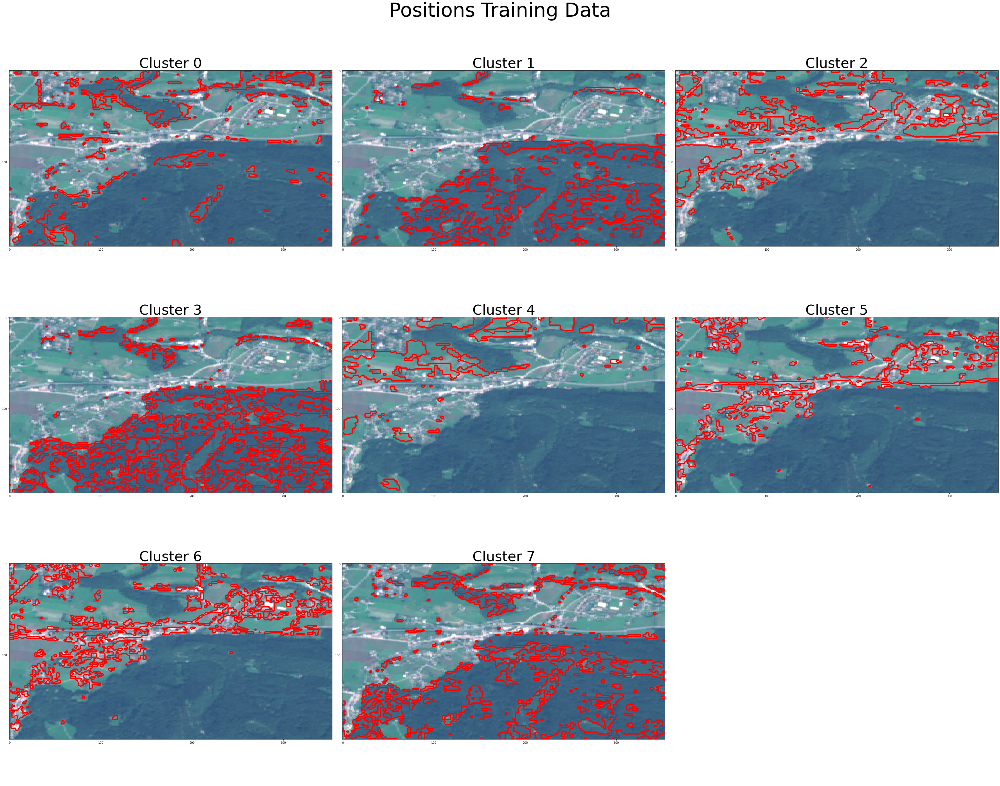

In [49]:
plt.figure()
# Prepare subplots
n_figures = n_clusters
n_rows = int(math.ceil((n_figures)**(1/2))) #add an extra row to have space for the colorbar
n_cols = int(math.ceil(n_figures/n_rows))
rows=[]
columns = []
for row in range(n_rows):
    for col in range(n_cols):
        rows.append(row)
        columns.append(col)

# Subplots and figure title
fig, axs = plt.subplots(n_rows, n_cols, figsize= (50,40))
fig.suptitle(f'Positions Training Data', fontsize = 70)

# Pixels training positions for the cluster
for sp in range(n_figures):
    cluster = labels==sp
    ax = axs[rows[sp], columns[sp]]
    image = testArray
    img = np.dstack((image[3, ...]*4, image[2, ...]*4, image[1, ...]*4))
    img = np.clip(img, 0, 1)
    img = ax.imshow(img)
    ax.contour(cluster, colors='red', linewidths=1.5)
    ax.set_xticks(np.arange(cluster.shape[1]+1, step=100))
    ax.set_yticks(np.arange(cluster.shape[0]+1, step=100))
    ax.set_title(f'Cluster {sp}', fontsize=50)

# delete empty figures
for image in range(n_figures, n_rows*n_cols):
    axs[rows[image], columns[image]].set_axis_off()

## Tight layout, save and show
plt.tight_layout()
fig.subplots_adjust(top=0.95)
plt.savefig(f'{figures_filepath}/clusters_TCC.png', format='png', dpi=300)
plt.show()

**DIFFERENCES BETWEEN CLUSTERS**

- Function to get the positions of all pixels differenciated by their cluster

In [50]:
allClusters_pixels = []
for cluster in range(n_clusters):
    cluster = labels == cluster
    result=np.where(cluster)
    pixels = list(zip(result[0], result[1]))
    allClusters_pixels.append(pixels)
print(f'len:{len(allClusters_pixels)}')

len:8


- Get data per cluster and represent

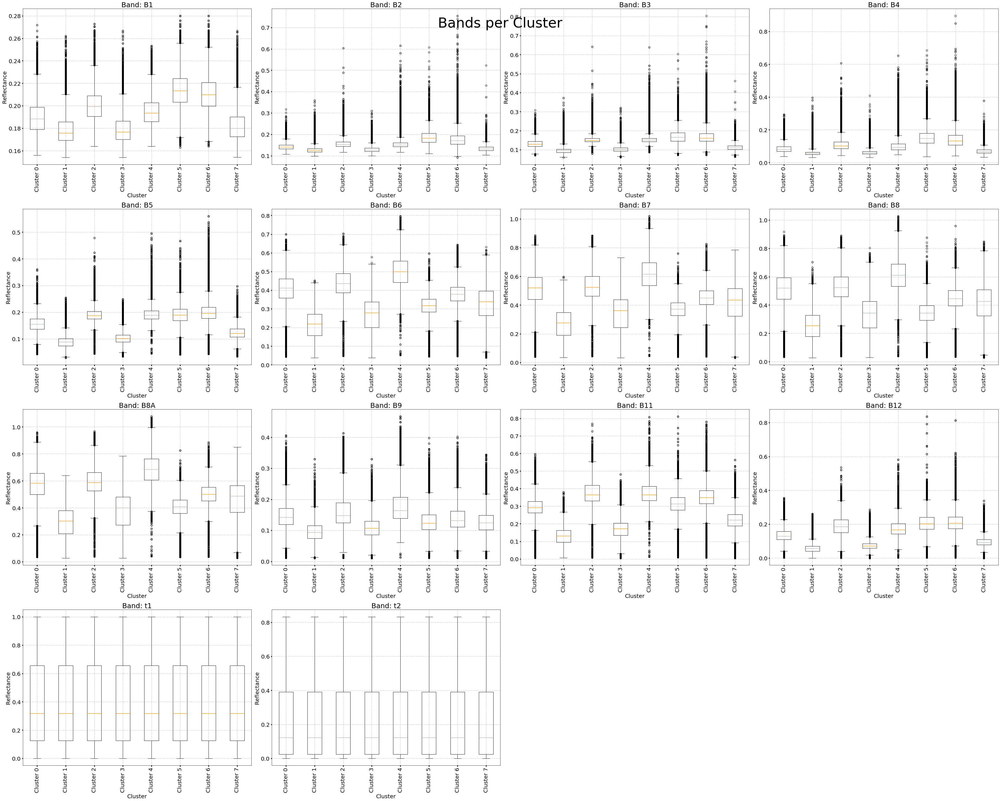

In [51]:
#Fill in number of figures:
n_figures = trainArray.shape[1]

#Prepare subplots
n_rows = int(math.ceil((n_figures)**(1/2)))
n_cols = int(math.ceil(n_figures/n_rows))
rows=[]
columns = []
for row in range(n_rows):
    for col in range(n_cols):
        rows.append(row)
        columns.append(col)

#Subplots and figure title
fig, axs = plt.subplots(n_rows, n_cols, figsize= (50,40))
fig.suptitle(f'Bands per Cluster', fontsize = 50)

##Plot random selection of pixels per band
for sp in range(n_figures):
    data = []
    label_data = []
    for cluster in range(n_clusters):
        data_cluster = []
        name = f'Cluster {cluster}'
        label_data.append(name)
        pixels = allClusters_pixels[cluster]
        for img in range(trainArray.shape[0]):
            for pixel in pixels:
                pixel = trainArray[img, sp, int(pixel[0]), int(pixel[1])]
                data_cluster.append(pixel)
        data.append(data_cluster)
    data = np.array(data, dtype=object)
    
    # Customize band plot
    ax = axs[rows[sp], columns[sp]]
    ax.boxplot(data.transpose())
    ax.set_title(f'Band: {bands[sp]}', fontsize=25)
    ax.set_xlabel('Cluster', fontsize=20)
    ax.set_ylabel('Reflectance', fontsize=20)
    ax.grid(True, linestyle='-.')
    ax.tick_params(labelsize=20, width=3)
    plt.sca(axs[rows[sp], columns[sp]])
    plt.xticks(list(range(1,len(label_data)+1)), label_data, rotation='vertical')

#delete empty figures
for image in range(n_figures, n_rows*n_cols):
    axs[rows[image], columns[image]].set_axis_off()

#save
plt.tight_layout()
fig.subplots_adjust(top=0.99)
plt.savefig(f'{figures_filepath}/boxplots_clusters.png', format='png', dpi=300)
plt.show()

# Get training pixels

**REPRESENTATIVENESS OF EACH PIXEL TO ITS CLUSTER**

Shape: (193, 354)


<Figure size 432x288 with 0 Axes>

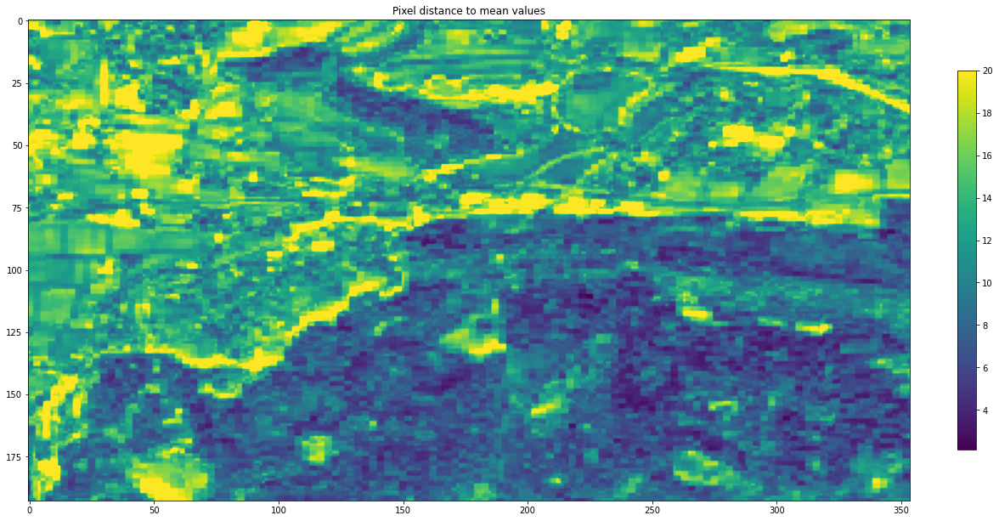

In [52]:
plt.figure()
# reshape to only bands
band_axis = np.concatenate(trainArray, axis=0)

# calculate sum of the difference per pixel to the mean of each band in its cluster
represent = []
for c in range(n_clusters):
    # select cluster
    cluster = band_axis*(labels == c)
    # difference to the mean per band
    diff_bands = []
    for b in cluster:
        diff = abs(b - np.full((trainArray.shape[2], trainArray.shape[3]), (np.sum(b)/np.count_nonzero(b)))*(labels == c))
        diff_bands.append(diff)
    diff_bands = np.array(diff_bands)

    # sum of the differences for all bands
    cluster_diff_bands = np.sum(diff_bands, axis=0)
    represent.append(cluster_diff_bands)

# Join all clusters for representation
represent = np.sum(np.array(represent), axis=0)
print(f'Shape: {represent.shape}')

# represent values
plt.figure(figsize=(20,20))
plt.imshow(represent, vmax=20)
plt.title('Pixel distance to mean values')
plt.colorbar(fraction=0.02)
plt.savefig(f'{figures_filepath}/pixel_representativity.png', format='png', dpi=300)
plt.show()

**SELECTION OF MOST REPRESENTATIVE PIXELS**

In [53]:
n_pixels = n_pixels
rep_pix_allCluster = []
for c in range(n_clusters):
    cluster = represent*(labels == c)
    print('---------------------------------------------------------------------------------------')
    print(f'Cluster: {c}')
    print('---------------------------------------------------------------------------------------')
    rep_pix_cluster = []
    for i in range(n_pixels):
        minval = np.nanmin(cluster[np.nonzero(cluster)])
        print(f'Min difference: {minval}')
        pixel = [(ix,iy) for ix, row in enumerate(cluster) for iy, i in enumerate(row) if i == minval][0]
        rep_pix_cluster.append(pixel)
        print(f'Pixel {i}: {pixel}')
        cluster[pixel[0]][pixel [1]] = 0
    print(f'Pixel Locations: {rep_pix_cluster}')
    rep_pix_allCluster.append(rep_pix_cluster)

---------------------------------------------------------------------------------------
Cluster: 0
---------------------------------------------------------------------------------------
Min difference: 6.089115100943813
Pixel 0: (103, 187)
Pixel Locations: [(103, 187)]
---------------------------------------------------------------------------------------
Cluster: 1
---------------------------------------------------------------------------------------
Min difference: 2.1302900953608823
Pixel 0: (110, 224)
Pixel Locations: [(110, 224)]
---------------------------------------------------------------------------------------
Cluster: 2
---------------------------------------------------------------------------------------
Min difference: 6.15640290758048
Pixel 0: (95, 38)
Pixel Locations: [(95, 38)]
---------------------------------------------------------------------------------------
Cluster: 3
---------------------------------------------------------------------------------------
Min 

**SHOW POSITIONS IN MAP**

<Figure size 432x288 with 0 Axes>

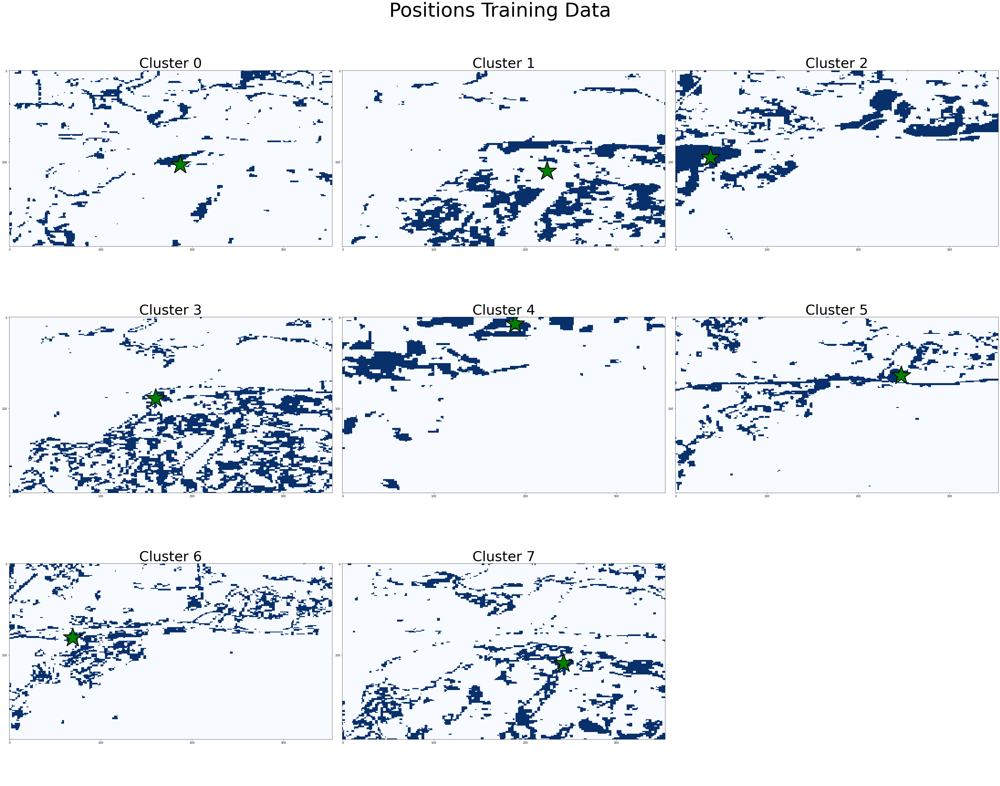

In [54]:
plt.figure()
# Prepare subplots
n_figures = n_clusters
n_rows = int(math.ceil((n_figures)**(1/2))) #add an extra row to have space for the colorbar
n_cols = int(math.ceil(n_figures/n_rows))
rows=[]
columns = []
for row in range(n_rows):
    for col in range(n_cols):
        rows.append(row)
        columns.append(col)

# Subplots and figure title
fig, axs = plt.subplots(n_rows, n_cols, figsize= (50,40))
fig.suptitle(f'Positions Training Data', fontsize = 70)

# Pixels training positions for the cluster
for sp in range(n_figures):
    cluster = labels==sp
    pixels = rep_pix_allCluster[sp]
    ax = axs[rows[sp], columns[sp]]
    img = ax.imshow(cluster, cmap='Blues', interpolation='nearest')
    for pixel in pixels:
        ax.scatter(pixel[1], pixel[0],color = 'green', marker='*', s=5000, edgecolor='black', linewidth=3)
    ax.set_xticks(np.arange(cluster.shape[1]+1, step=100))
    ax.set_yticks(np.arange(cluster.shape[0]+1, step=100))
    ax.set_title(f'Cluster {sp}', fontsize=50)

# delete empty figures
for image in range(n_figures, n_rows*n_cols):
    axs[rows[image], columns[image]].set_axis_off()

## Tight layout, save and show
plt.tight_layout()
fig.subplots_adjust(top=0.95)
plt.savefig(f'{figures_filepath}/training_pixel_positions.png', format='png', dpi=300)
plt.show()

**GET TRAINING DATA**

In [55]:
training_data = []
for b in range(len(bands)):
    data = []
    label_data = []
    for cluster in range(n_clusters):
        data_cluster = []
        name = f'Cluster {cluster}'
        label_data.append(name)
        pixels = rep_pix_allCluster[cluster]
        for img in range(trainArray.shape[0]):
            for pixel in pixels:
                pixel = trainArray[img, b, pixel[0], pixel[1]]
                data_cluster.append(pixel)
        data.append(data_cluster)
    training_data.append(data)
training_data = np.array(training_data)
print('bands, clusters, images x pixels')
print(training_data.shape)

bands, clusters, images x pixels
(14, 8, 37)


**SHOW TRAINING DATA: BOXPLOTS**

<Figure size 432x288 with 0 Axes>

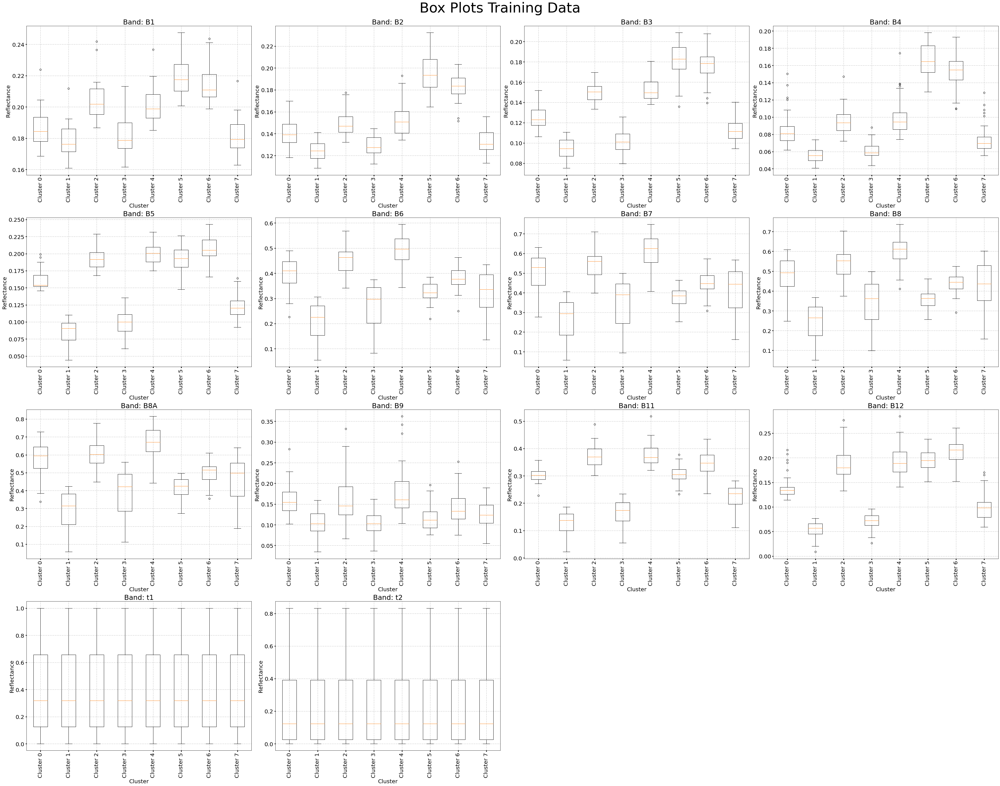

In [56]:
plt.figure()
# Prepare subplots
n_figures = len(bands)
n_rows = int(math.ceil((n_figures)**(1/2))) #add an extra row to have space for the colorbar
n_cols = int(math.ceil(n_figures/n_rows))
rows=[]
columns = []
for row in range(n_rows):
    for col in range(n_cols):
        rows.append(row)
        columns.append(col)

# Subplots and figure title
fig, axs = plt.subplots(n_rows, n_cols, figsize= (50,40))
fig.suptitle(f'Box Plots Training Data', fontsize = 50)

# Represent Data
for sp in range(n_figures):     
    data = training_data[sp]
    ax = axs[rows[sp], columns[sp]]
    ax.boxplot(data.transpose())
    ax.set_title(f'Band: {bands[sp]}', fontsize=25)
    ax.set_xlabel('Cluster', fontsize=20)
    ax.set_ylabel('Reflectance', fontsize=20)
    ax.grid(True, linestyle='-.')
    ax.tick_params(labelsize=20, width=3)
    plt.sca(axs[rows[sp], columns[sp]])
    plt.xticks(list(range(1,len(label_data)+1)), label_data, rotation='vertical')

# delete empty figures
for image in range(n_figures, n_rows*n_cols):
    axs[rows[image], columns[image]].set_axis_off()

## Tight layout, save and show
plt.tight_layout()
fig.subplots_adjust(top=0.95)
plt.savefig(f'{figures_filepath}/boxplots_training.png', format='png', dpi=300)
plt.show()

**SHOW TRAINING DATA: BANDS**

<Figure size 432x288 with 0 Axes>

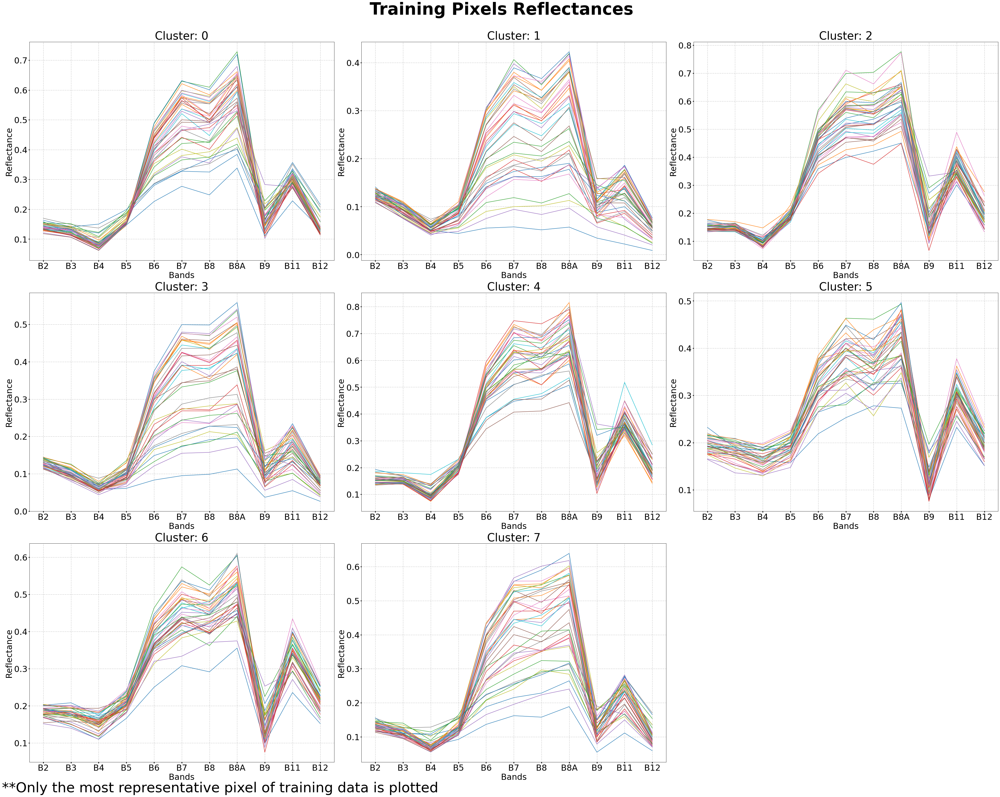

In [57]:
plt.figure()
# Prepare subplots
n_figures = n_clusters
n_rows = int(math.ceil((n_figures)**(1/2))) #add an extra row to have space for the colorbar
n_cols = int(math.ceil(n_figures/n_rows))
rows=[]
columns = []
for row in range(n_rows):
    for col in range(n_cols):
        rows.append(row)
        columns.append(col)

# Subplots and figure title
fig, axs = plt.subplots(n_rows, n_cols, figsize= (50,40))
fig.suptitle(f'Training Pixels Reflectances', fontsize = 60, fontweight="bold")

# Represent Data
for sp in range(n_figures):     
    data = training_data[1:-2,sp,:]
    ax = axs[rows[sp], columns[sp]]
    ax.plot(data)
    ax.set_title(f'Cluster: {sp}', fontsize=40)
    ax.set_xlabel('Bands', fontsize=30)
    ax.set_ylabel('Reflectance', fontsize=30)
    ax.grid(True, linestyle='-.')
    ax.tick_params(labelsize=30, width=3)
    ax.set_xticks(range(data.shape[0]))
    ax.set_xticklabels(bands[1:-2]);

# delete empty figures
for image in range(n_figures, n_rows*n_cols):
    axs[rows[image], columns[image]].set_axis_off()

# add a comment
textstr = '**Only the most representative pixel of training data is plotted'
plt.gcf().text(0, -0.01, textstr, fontsize=50)

## Tight layout, save and show
plt.tight_layout()
fig.subplots_adjust(top=0.93)
plt.savefig(f'{figures_filepath}/bandsShape_training.png', format='png', dpi=300)
plt.show()

**SHOW TRAINING DATA: BANDS ALONG TIME**

<Figure size 432x288 with 0 Axes>

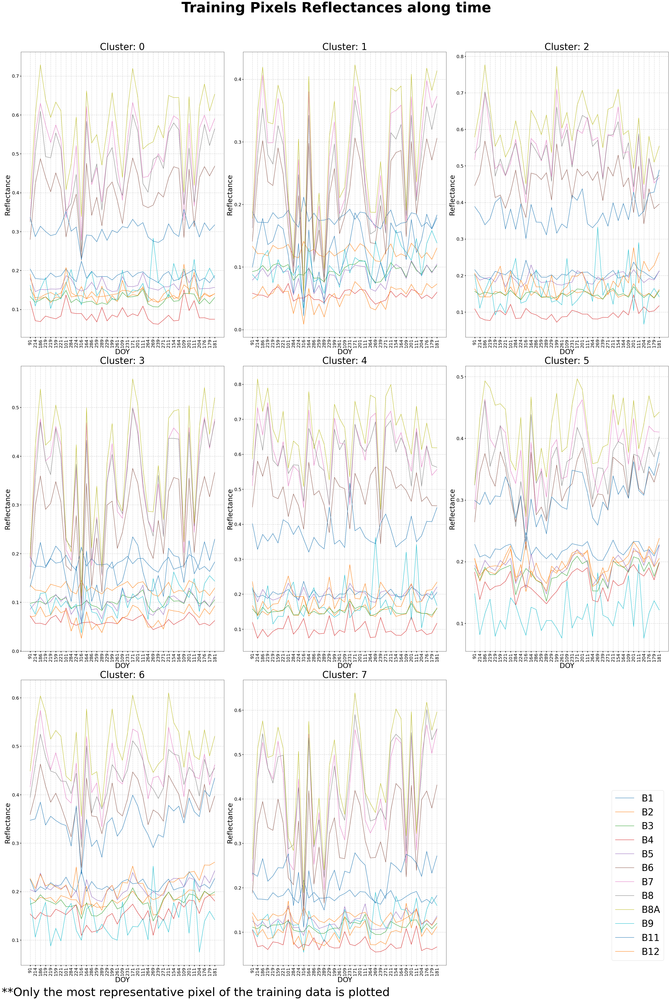

In [58]:
plt.figure()
# Prepare subplots
n_figures = n_clusters
n_rows = int(math.ceil((n_figures)**(1/2))) #add an extra row to have space for the colorbar
n_cols = int(math.ceil(n_figures/n_rows))
rows=[]
columns = []
for row in range(n_rows):
    for col in range(n_cols):
        rows.append(row)
        columns.append(col)

# Subplots and figure title
fig, axs = plt.subplots(n_rows, n_cols, figsize= (40,60))
fig.suptitle(f'Training Pixels Reflectances along time', fontsize = 60, fontweight="bold")

# Represent Data
for sp in range(n_figures):     
    data = np.transpose(training_data[:-2,sp,:])
    ax = axs[rows[sp], columns[sp]]
    im = ax.plot(data)
    ax.set_title(f'Cluster: {sp}', fontsize=40)
    ax.set_xlabel('DOY', fontsize=30)
    ax.set_ylabel('Reflectance', fontsize=30)
    ax.grid(True, linestyle='-.')
    ax.tick_params(labelsize=20, width=3)
    ax.set_xticks(range(data.shape[0]))
    ax.set_xticklabels(doys, rotation=90);

# delete empty figures
for image in range(n_figures, n_rows*n_cols):
    axs[rows[image], columns[image]].set_axis_off()
    
# legend
leg = plt.legend(im, bands[:-2], loc=4, fontsize = 40)

# add a comment
textstr = '**Only the most representative pixel of the training data is plotted'
plt.gcf().text(0, -0.01, textstr, fontsize=50)

## Tight layout, save and show
plt.tight_layout()
fig.subplots_adjust(top=0.93)
plt.savefig(f'{figures_filepath}/bandsShapeAlongTime_training.png', format='png', dpi=300)
plt.show()

---------------------------------------------------------------------------------------------------------

# Autoencoder

-------------------------------------------------------------------------------------------
                                    CLUSTER 0 --- AUTOENCODER 0
    ------------------------------------------------------------------------------------------------------
Preparing training data...
Training the model...
Min error: 0.015695668756961823
INFO:tensorflow:Assets written to: /Users/clara/Projects/A4_Cube/Codes/Strobler/correcData/Models/Autoencoder_0/assets


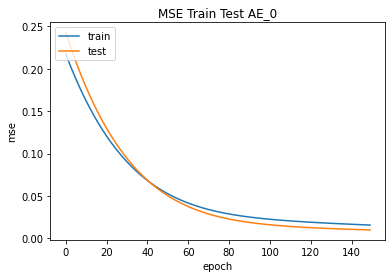

Min error: 0.008892267011106014
INFO:tensorflow:Assets written to: /Users/clara/Projects/A4_Cube/Codes/Strobler/correcData/Models/Autoencoder_0/assets


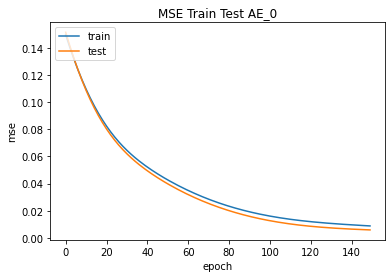

Min error: 0.01637088693678379
Min error: 0.01447108294814825
Min error: 0.01685287430882454
Min error: 0.014254547655582428
-------------------------------------------------------------------------------------------
                                    CLUSTER 1 --- AUTOENCODER 1
    ------------------------------------------------------------------------------------------------------
Preparing training data...
Training the model...
Epoch 00120: early stopping
Min error: 0.009787519462406635
INFO:tensorflow:Assets written to: /Users/clara/Projects/A4_Cube/Codes/Strobler/correcData/Models/Autoencoder_1/assets


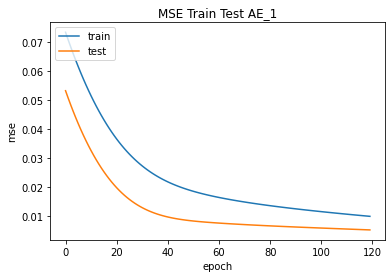

Min error: 0.00802151020616293
INFO:tensorflow:Assets written to: /Users/clara/Projects/A4_Cube/Codes/Strobler/correcData/Models/Autoencoder_1/assets


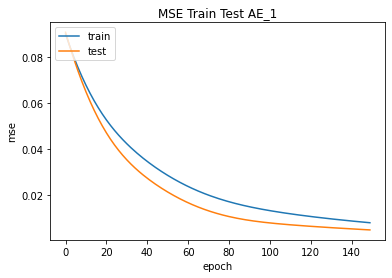

Epoch 00135: early stopping
Min error: 0.004400091245770454
INFO:tensorflow:Assets written to: /Users/clara/Projects/A4_Cube/Codes/Strobler/correcData/Models/Autoencoder_1/assets


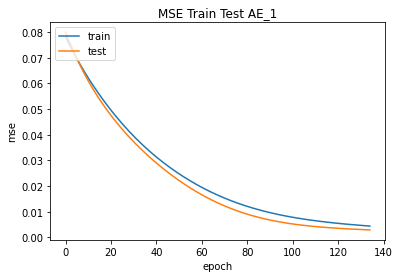

Min error: 0.01055106520652771
Min error: 0.012410109862685204
Epoch 00150: early stopping
Min error: 0.00574943283572793
-------------------------------------------------------------------------------------------
                                    CLUSTER 2 --- AUTOENCODER 2
    ------------------------------------------------------------------------------------------------------
Preparing training data...
Training the model...
Min error: 0.01319917757064104
INFO:tensorflow:Assets written to: /Users/clara/Projects/A4_Cube/Codes/Strobler/correcData/Models/Autoencoder_2/assets


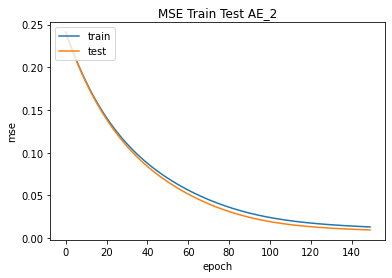

Min error: 0.02228654734790325
Min error: 0.016216663643717766
Min error: 0.014736668206751347
Min error: 0.013705851510167122
Epoch 00140: early stopping
Min error: 0.010431256145238876
INFO:tensorflow:Assets written to: /Users/clara/Projects/A4_Cube/Codes/Strobler/correcData/Models/Autoencoder_2/assets


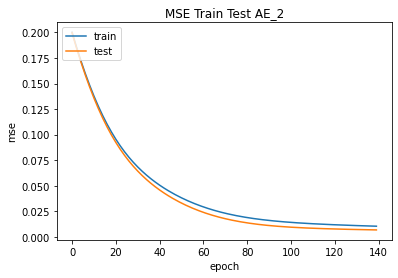

-------------------------------------------------------------------------------------------
                                    CLUSTER 3 --- AUTOENCODER 3
    ------------------------------------------------------------------------------------------------------
Preparing training data...
Training the model...
Min error: 0.012544479221105576
INFO:tensorflow:Assets written to: /Users/clara/Projects/A4_Cube/Codes/Strobler/correcData/Models/Autoencoder_3/assets


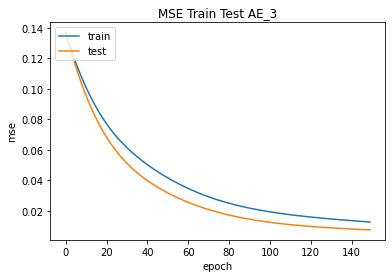

Min error: 0.010026069357991219
INFO:tensorflow:Assets written to: /Users/clara/Projects/A4_Cube/Codes/Strobler/correcData/Models/Autoencoder_3/assets


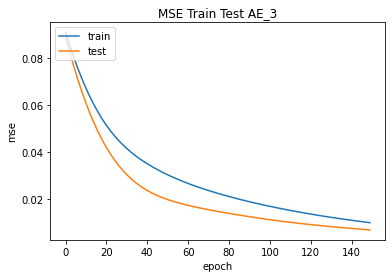

Min error: 0.012134833261370659
Min error: 0.010893745347857475
Min error: 0.01515347883105278
Min error: 0.00960309337824583
INFO:tensorflow:Assets written to: /Users/clara/Projects/A4_Cube/Codes/Strobler/correcData/Models/Autoencoder_3/assets


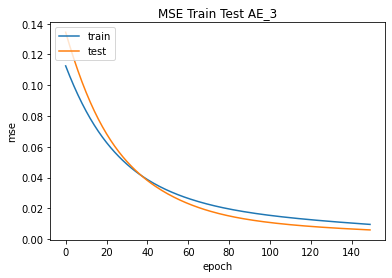

-------------------------------------------------------------------------------------------
                                    CLUSTER 4 --- AUTOENCODER 4
    ------------------------------------------------------------------------------------------------------
Preparing training data...
Training the model...
Min error: 0.021354181692004204
INFO:tensorflow:Assets written to: /Users/clara/Projects/A4_Cube/Codes/Strobler/correcData/Models/Autoencoder_4/assets


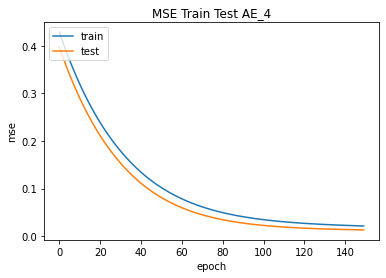

Min error: 0.00958112720400095
INFO:tensorflow:Assets written to: /Users/clara/Projects/A4_Cube/Codes/Strobler/correcData/Models/Autoencoder_4/assets


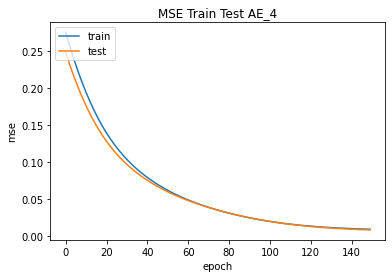

Min error: 0.014624295756220818
Min error: 0.009549524635076523
INFO:tensorflow:Assets written to: /Users/clara/Projects/A4_Cube/Codes/Strobler/correcData/Models/Autoencoder_4/assets


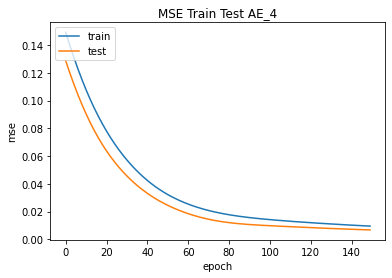

Epoch 00124: early stopping
Min error: 0.010678506456315517
Epoch 00142: early stopping
Min error: 0.007249100599437952
INFO:tensorflow:Assets written to: /Users/clara/Projects/A4_Cube/Codes/Strobler/correcData/Models/Autoencoder_4/assets


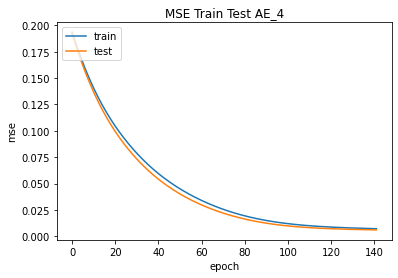

-------------------------------------------------------------------------------------------
                                    CLUSTER 5 --- AUTOENCODER 5
    ------------------------------------------------------------------------------------------------------
Preparing training data...
Training the model...
Min error: 0.016440093517303467
INFO:tensorflow:Assets written to: /Users/clara/Projects/A4_Cube/Codes/Strobler/correcData/Models/Autoencoder_5/assets


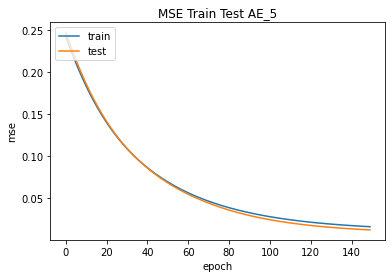

Min error: 0.011313789524137974
INFO:tensorflow:Assets written to: /Users/clara/Projects/A4_Cube/Codes/Strobler/correcData/Models/Autoencoder_5/assets


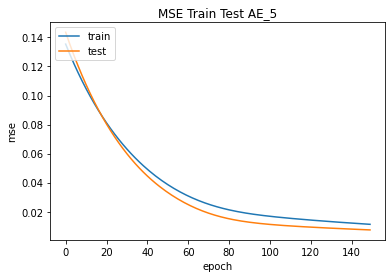

Epoch 00142: early stopping
Min error: 0.009463678114116192
INFO:tensorflow:Assets written to: /Users/clara/Projects/A4_Cube/Codes/Strobler/correcData/Models/Autoencoder_5/assets


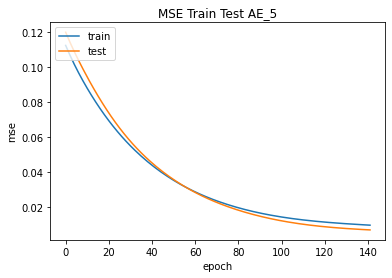

Min error: 0.011630096472799778
Min error: 0.01515117660164833
Min error: 0.013192103244364262
-------------------------------------------------------------------------------------------
                                    CLUSTER 6 --- AUTOENCODER 6
    ------------------------------------------------------------------------------------------------------
Preparing training data...
Training the model...
Min error: 0.00931251235306263
INFO:tensorflow:Assets written to: /Users/clara/Projects/A4_Cube/Codes/Strobler/correcData/Models/Autoencoder_6/assets


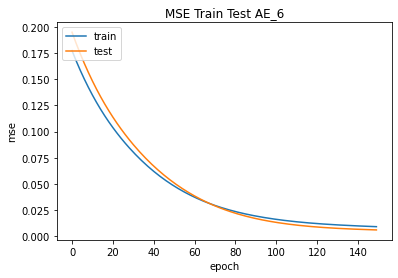

Min error: 0.013329112902283669
Epoch 00129: early stopping
Min error: 0.006610974203795195
INFO:tensorflow:Assets written to: /Users/clara/Projects/A4_Cube/Codes/Strobler/correcData/Models/Autoencoder_6/assets


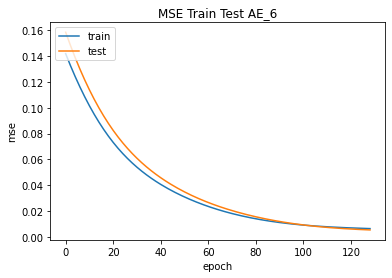

Min error: 0.015678953379392624
Min error: 0.018381308764219284
Min error: 0.012794620357453823
-------------------------------------------------------------------------------------------
                                    CLUSTER 7 --- AUTOENCODER 7
    ------------------------------------------------------------------------------------------------------
Preparing training data...
Training the model...
Epoch 00129: early stopping
Min error: 0.01166550349444151
INFO:tensorflow:Assets written to: /Users/clara/Projects/A4_Cube/Codes/Strobler/correcData/Models/Autoencoder_7/assets


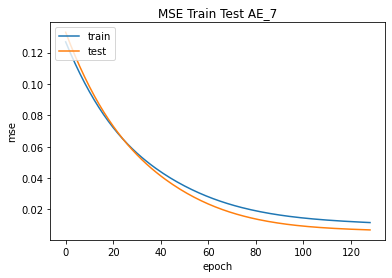

Min error: 0.00804627500474453
INFO:tensorflow:Assets written to: /Users/clara/Projects/A4_Cube/Codes/Strobler/correcData/Models/Autoencoder_7/assets


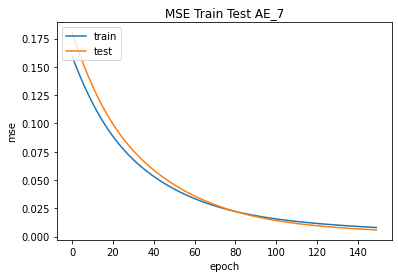

Min error: 0.009161668829619884
Min error: 0.013849135488271713
Min error: 0.013711412437260151
Min error: 0.0055923196487128735
INFO:tensorflow:Assets written to: /Users/clara/Projects/A4_Cube/Codes/Strobler/correcData/Models/Autoencoder_7/assets


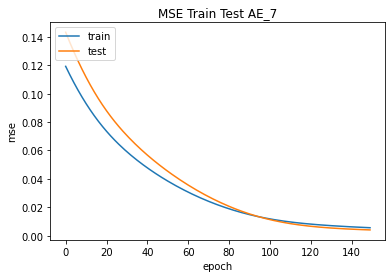

Running time AEs --- minutes ----6.3951575795809426


In [59]:
# early stopping
es = keras.callbacks.EarlyStopping(monitor = 'mse', mode = 'min', min_delta = 0.001, verbose = 2, patience = 12) 

start = time.time()

for ae in range(n_clusters):

    lowest_error = 100000000

    print(f'''-------------------------------------------------------------------------------------------
                                    CLUSTER {ae} --- AUTOENCODER {ae}
    ------------------------------------------------------------------------------------------------------''')

    ## Create a folder for the AE
    # Model filepaths
    folder = f'Autoencoder_{ae}'
    mf = os.path.join(model_filepath, folder)
    if not os.path.exists(mf):
          os.mkdir(mf)
    # Figures filepaths
    mf2 = os.path.join(figures_filepath, 'Training')
    if not os.path.exists(mf2):
          os.mkdir(mf2)
    mf3 = os.path.join(figures_filepath, 'Error')
    if not os.path.exists(mf3):
          os.mkdir(mf3)
    mf4 = os.path.join(figures_filepath, 'Reflectance')
    if not os.path.exists(mf4):
          os.mkdir(mf4)


    ## Prepare training data
    print('Preparing training data...')

    
    # Data of the selected pixels
    data = np.transpose(training_data[:, ae, :])


    ## Train AE
    print('Training the model...')
    for n in range(6):
        # Create model
        model = Sequential()

        # Create layers
        model.add(Dense(units=10, activation='linear', input_dim=len(bands)))
        model.add(Dense(units=len(bands), activation='linear'))

        # Compile model (a traditional default value for the learning rate is 0.1 or 0.01)
        opt = keras.optimizers.Adam(learning_rate=0.001)
        tf.keras.losses.MeanSquaredError(reduction="auto", name="mean_squared_error")
        model.compile(optimizer=opt, loss="mean_squared_error", metrics=['mse'])

        # Train
        X_train, X_test = train_test_split(data, test_size=0.2, random_state=1)
        history = model.fit(x=X_train, y=X_train,
                            epochs=150,
                            batch_size= None,
                            shuffle=True,
                            validation_data=(X_test,X_test),
                            verbose=0,
                            callbacks=[es])

        # Save best model
        error = min(history.history['mse'])
        print(f'Min error: {error}')

        if error < lowest_error:
            lowest_error = error
            model.save(mf, overwrite=True, include_optimizer=True)
            # Plot train-test curves
            plt.plot(history.history['mse'])
            plt.plot(history.history['val_mse'])
            plt.title(f'MSE Train Test AE_{ae}')
            plt.ylabel('mse')
            plt.xlabel('epoch')
            plt.legend(['train', 'test'], loc='upper left')
            plt.savefig(f'{mf2}/traintestCurvesAE_{ae}.png', format='png', dpi=300)
            plt.show()
        pass

end = time.time()

print(f'Running time AEs --- minutes ----{(end-start)/60}')

# Predictions

In [60]:
# Figures filepaths
mf2 = os.path.join(figures_filepath, 'Training')
mf3 = os.path.join(figures_filepath, 'Error')
mf4 = os.path.join(figures_filepath, 'Reflectance')

# PREDICT TRAIN DATA

In [61]:
TRAINpredictions = []
for ae in list(range(n_clusters)):

    mf = f'{model_filepath}/Autoencoder_{ae}/'
    
    # Upload best model
    model = keras.models.load_model(mf)
       
    ## Prediction
    print(f'Predicting autoencoder {ae}...')
    start_p = time.time()
    TRAINpredicted_or = model.predict(x=TRAINarray_ae, verbose=1)
    
    # Convert to original shape
    TRAINpredicted = TRAINpredicted_or.transpose()
    TRAINpredicted = TRAINpredicted.reshape(trainArray.shape[1], trainArray.shape[0], trainArray.shape[2], trainArray.shape[3])
    images = []
    for img in range(trainArray.shape[0]):
        bands_img = []
        for b in range(trainArray.shape[1]):
            band = TRAINpredicted[b, img, :, :]
            bands_img.append(band)
        images.append(bands_img)
    TRAINpredicted = np.array(images)
    TRAINpredictions.append(TRAINpredicted)
    end_p = time.time()
    print(f'Prediction time AE_{ae} ---minutes--- {(end_p-start_p)/60}')

TRAINpredictions = np.array(TRAINpredictions)

Predicting autoencoder 0...
78998/78998 [==============================] - 66s 830us/step
Prediction time AE_0 ---minutes--- 1.130303716659546
Predicting autoencoder 1...
78998/78998 [==============================] - 61s 772us/step
Prediction time AE_1 ---minutes--- 1.0422842144966125
Predicting autoencoder 2...
78998/78998 [==============================] - 62s 779us/step
Prediction time AE_2 ---minutes--- 1.0428087671597799
Predicting autoencoder 3...
78998/78998 [==============================] - 55s 699us/step
Prediction time AE_3 ---minutes--- 0.935076912244161
Predicting autoencoder 4...
78998/78998 [==============================] - 52s 659us/step
Prediction time AE_4 ---minutes--- 0.8888202508290609
Predicting autoencoder 5...
78998/78998 [==============================] - 54s 686us/step
Prediction time AE_5 ---minutes--- 0.9272623141606648
Predicting autoencoder 6...
78998/78998 [==============================] - 52s 656us/step
Prediction time AE_6 ---minutes--- 0.88197888533

**SHOW PIXEL RECONSTRUCTION (MOST REPRESENTATIVE PIXEL PER CLUSTER)**

-------------------------------------------------------------------------------------------
                                    CLUSTER 0 --- AUTOENCODER 0
    ------------------------------------------------------------------------------------------------------


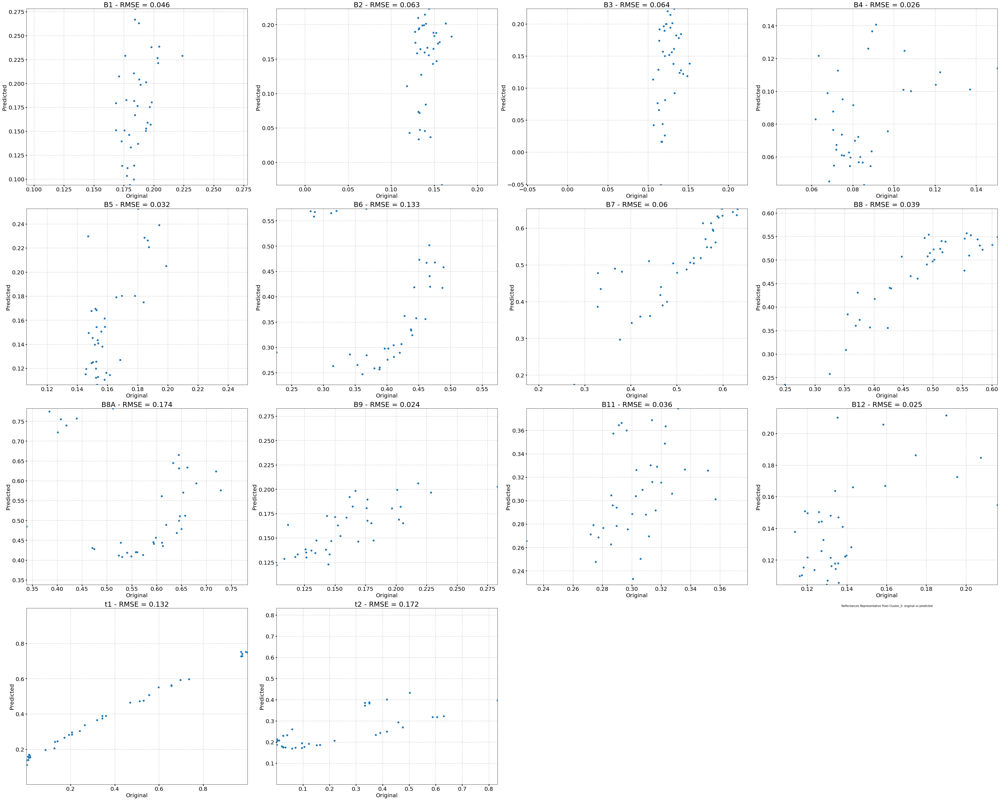

-------------------------------------------------------------------------------------------
                                    CLUSTER 1 --- AUTOENCODER 1
    ------------------------------------------------------------------------------------------------------


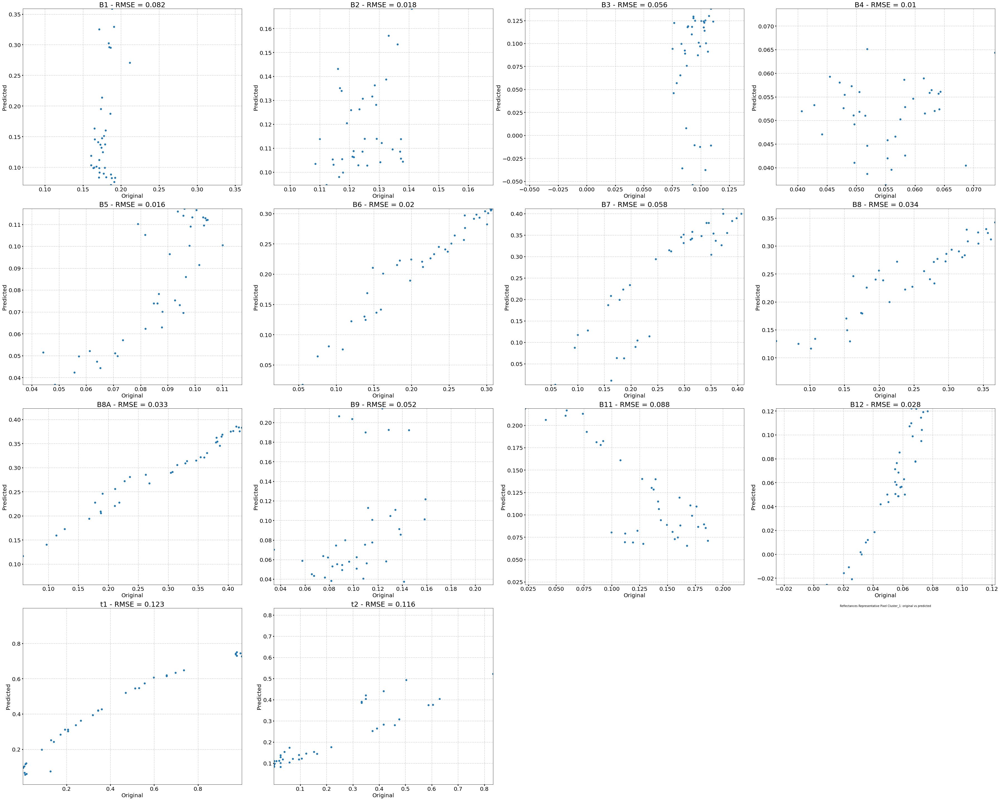

-------------------------------------------------------------------------------------------
                                    CLUSTER 2 --- AUTOENCODER 2
    ------------------------------------------------------------------------------------------------------


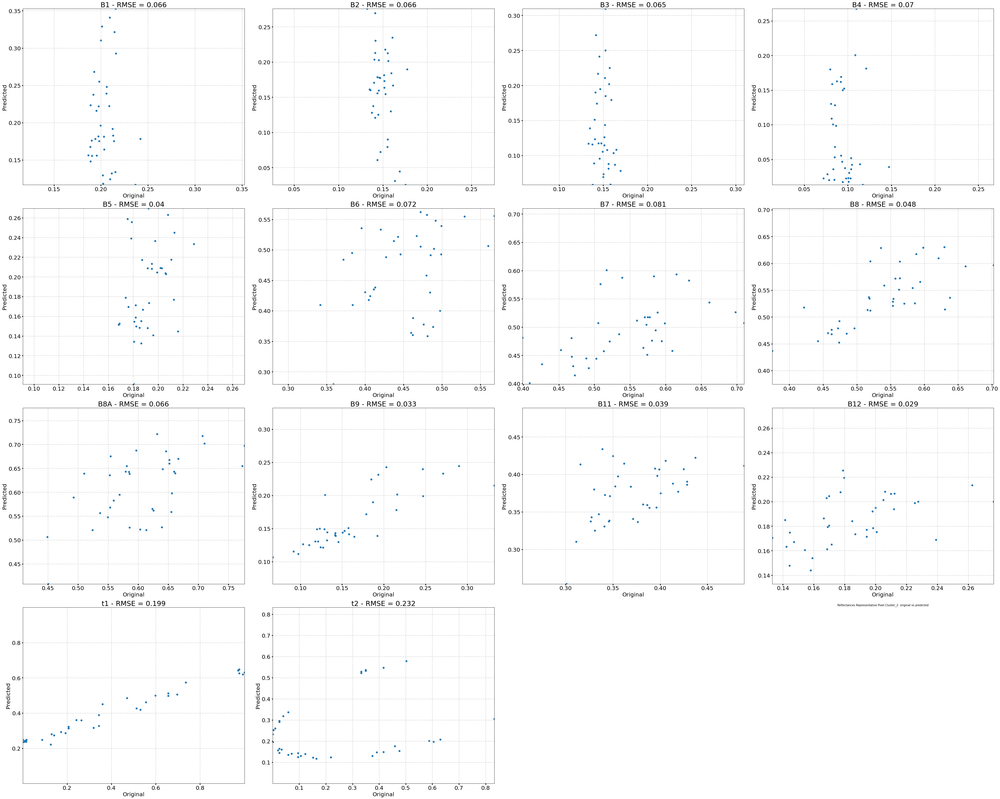

-------------------------------------------------------------------------------------------
                                    CLUSTER 3 --- AUTOENCODER 3
    ------------------------------------------------------------------------------------------------------


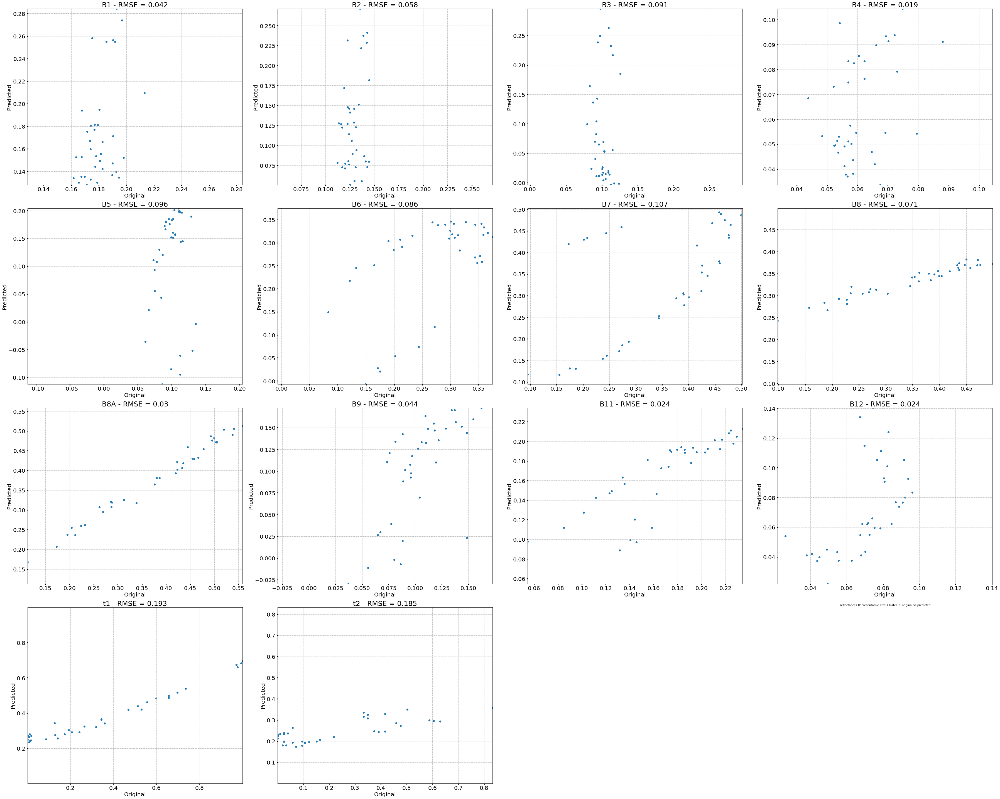

-------------------------------------------------------------------------------------------
                                    CLUSTER 4 --- AUTOENCODER 4
    ------------------------------------------------------------------------------------------------------


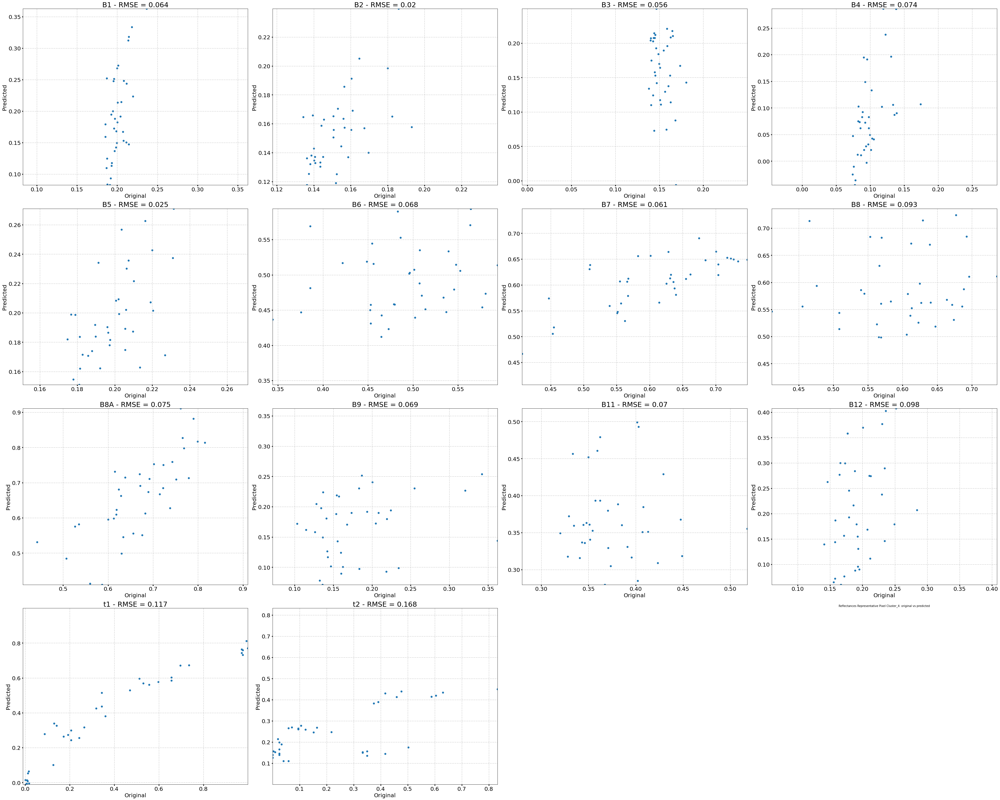

-------------------------------------------------------------------------------------------
                                    CLUSTER 5 --- AUTOENCODER 5
    ------------------------------------------------------------------------------------------------------


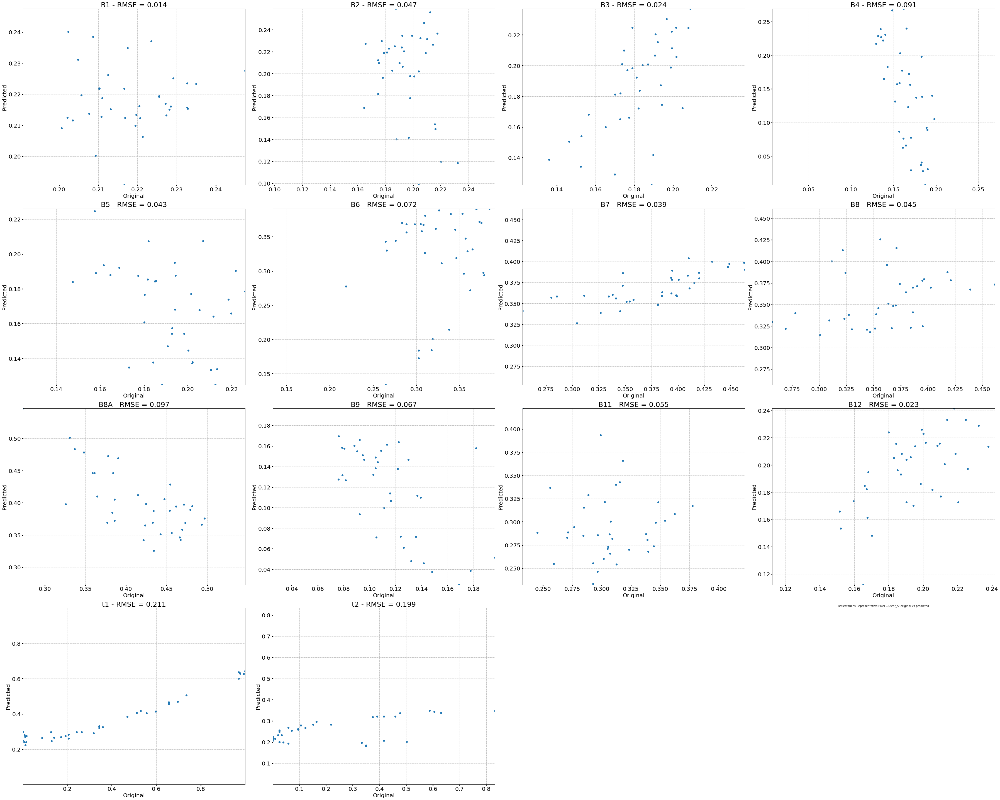

-------------------------------------------------------------------------------------------
                                    CLUSTER 6 --- AUTOENCODER 6
    ------------------------------------------------------------------------------------------------------


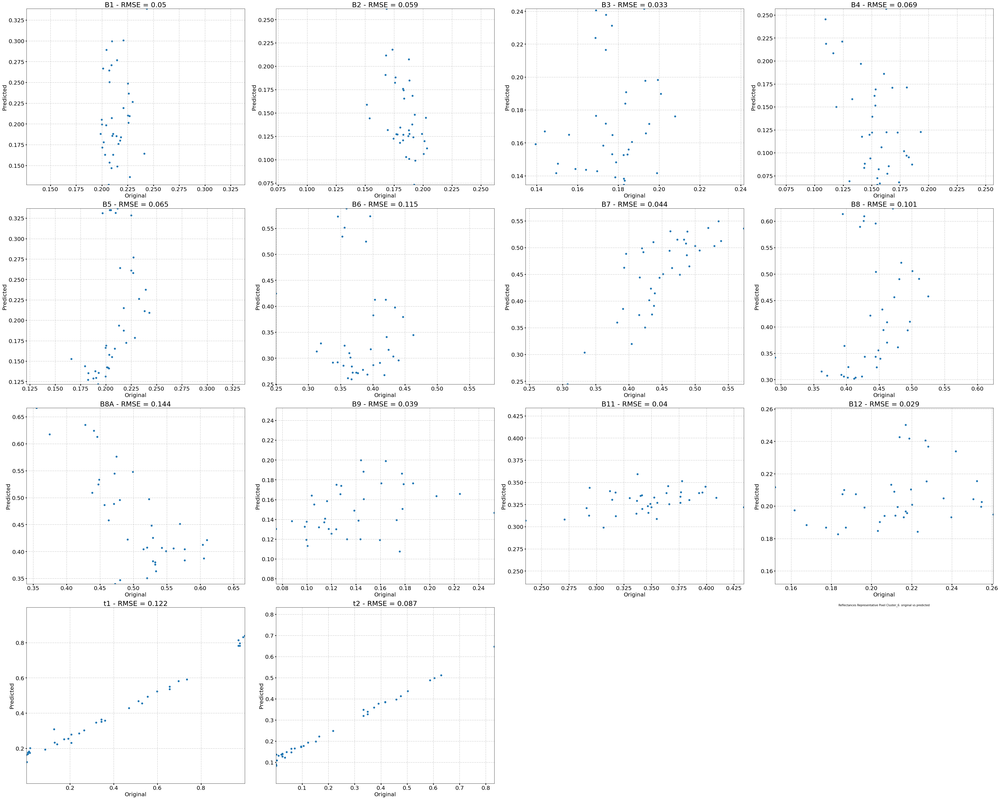

-------------------------------------------------------------------------------------------
                                    CLUSTER 7 --- AUTOENCODER 7
    ------------------------------------------------------------------------------------------------------


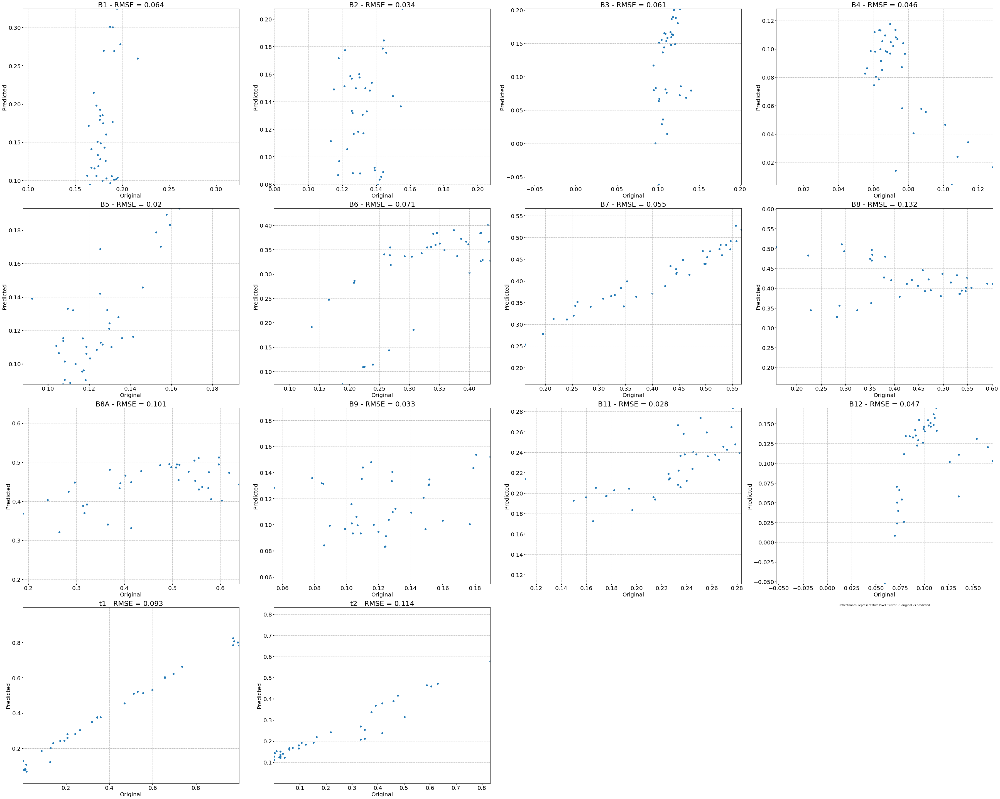

In [62]:
from matplotlib.cbook import flatten
# Prepare subplots
n_figures = len(bands)
n_rows = int(math.ceil((n_figures)**(1/2))) #add an extra row to have space for the colorbar
n_cols = int(math.ceil(n_figures/n_rows))
rows=[]
columns = []
for row in range(n_rows):
    for col in range(n_cols):
        rows.append(row)
        columns.append(col)

# Show reflectances for each AE
for ae in range(n_clusters):
    print(f'''-------------------------------------------------------------------------------------------
                                    CLUSTER {ae} --- AUTOENCODER {ae}
    ------------------------------------------------------------------------------------------------------''')
    
    # Plot reflectances original pixel vs. reconstructed
    TRAINpredicted = TRAINpredictions[ae]
    pixels = rep_pix_allCluster[ae]
    pixel = pixels[0]
    fig, axs = plt.subplots(n_rows, n_cols, figsize= (50,40))
    rms_l = []
    
    # reflectance bands: B1, B2, B3, B4, B5
    for sp in range(n_figures):
        ori_sublist = []
        pre_sublist = []
        for pixel in pixels:
            ori_pixel = list(trainArray[:,sp, pixel[0], pixel[1]])
            ori_sublist.append(ori_pixel)
            pre_pixel = list(TRAINpredicted[:,sp, pixel[0], pixel[1]])
            pre_sublist.append(pre_pixel)
        #print(ori_sublist)
        #print(pre_sublist)
        ori = list(flatten(ori_sublist))
        pre = list(flatten(pre_sublist))
        rms = round(mean_squared_error(ori, pre, squared=False),3)
        rms_l.append(rms)
        ax = axs[rows[sp], columns[sp]]
        im = ax.scatter(ori, pre)
        ax.set_xlim(min(min(list(ori)), min(list(pre))), max(max(list(ori)), max(list(pre))))
        ax.set_ylim(min(min(list(ori)), min(list(pre))), max(max(list(ori)), max(list(pre))))
        ax.set_title(f'{bands[sp]} - RMSE = {rms}', fontsize=25)
        ax.set_xlabel('Original', fontsize=20)
        ax.set_ylabel('Predicted', fontsize=20)
        ax.grid(True, linestyle='-.')
        ax.tick_params(labelsize=20, width=3)
    
    # delete empty figures
    for sp in range(n_figures, n_rows*n_cols):
        axs[rows[sp], columns[sp]].set_axis_off()

    plt.title(f'Reflectances Representative Pixel Cluster_{ae}: original vs predicted', fontsize=10)
    plt.tight_layout()
    plt.savefig(f'{mf4}/OriginalvsReconstructed_AE_{ae}.png', format='png', dpi=300)
    plt.show()

# PREDICT TEST DATA

In [63]:
predictions = []
for ae in list(range(n_clusters)):

    mf = f'{model_filepath}/Autoencoder_{ae}/'
    
    # Upload best model
    model = keras.models.load_model(mf)
       
    ## Prediction
    print(f'Predicting autoencoder {ae}...')
    start_p = time.time()
    predicted_or = model.predict(x=array_ae, verbose=1)

    # Convert to original shape
    predicted = predicted_or.transpose()
    predicted = predicted. reshape(testArray.shape[0], testArray.shape[1], testArray.shape[2])
    predictions.append(predicted)
    end_p = time.time()
    print(f'Prediction time AE_{ae} ---minutes--- {(end_p-start_p)/60}')

predictions = np.array(predictions)

Predicting autoencoder 0...
2136/2136 [==============================] - 1s 680us/step
Prediction time AE_0 ---minutes--- 0.026202853520711264
Predicting autoencoder 1...
2136/2136 [==============================] - 1s 671us/step
Prediction time AE_1 ---minutes--- 0.025293131669362385
Predicting autoencoder 2...
2136/2136 [==============================] - 1s 654us/step
Prediction time AE_2 ---minutes--- 0.024447882175445558
Predicting autoencoder 3...
2136/2136 [==============================] - 1s 658us/step
Prediction time AE_3 ---minutes--- 0.024659148852030435
Predicting autoencoder 4...
2136/2136 [==============================] - 1s 650us/step
Prediction time AE_4 ---minutes--- 0.024268682797749838
Predicting autoencoder 5...
2136/2136 [==============================] - 1s 646us/step
Prediction time AE_5 ---minutes--- 0.024109415213267007
Predicting autoencoder 6...
2136/2136 [==============================] - 2s 760us/step
Prediction time AE_6 ---minutes--- 0.02830359935760498


**Calculate error: RMSE**

In [64]:
error_list = []
ae=0
for predicted in predictions:    
    print(f'Calculating error autoencoder {ae}...')
    ae=ae+1
    
    # RMSE y=bands of one image -> predicted vs original + mean of the RMSE between all images
    dif = (predicted[:-2,:,:]-testArray[:-2,:,:])**2
    suma = np.sum(dif, axis = 0)
    div = suma/(testArray.shape[0]-2)
    square = div**(1/2)
    error_list.append(square)

error_list = np.array(error_list)

Calculating error autoencoder 0...
Calculating error autoencoder 1...
Calculating error autoencoder 2...
Calculating error autoencoder 3...
Calculating error autoencoder 4...
Calculating error autoencoder 5...
Calculating error autoencoder 6...
Calculating error autoencoder 7...


**Plot error**

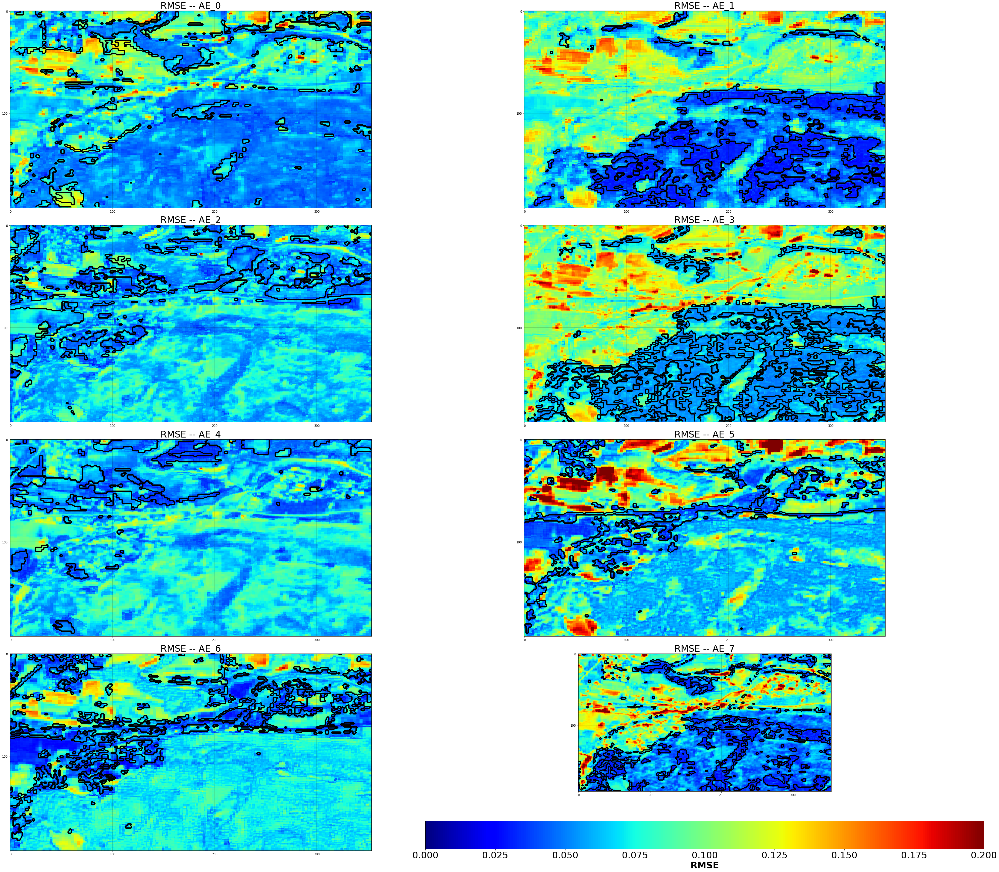

In [65]:
# Prepare subplots
n_figures = n_clusters
n_rows = int(math.ceil((n_figures)**(1/2))) +1
n_cols = int(math.ceil(n_figures/n_rows))
fig, axs = plt.subplots(n_rows, n_cols, figsize= (50,40))
rows=[]
columns = []
for row in range(n_rows):
    for col in range(n_cols):
        rows.append(row)
        columns.append(col)

# RMSE in each subplot: plot error matrices
cm = 'jet'
for ae in range(n_figures):
    mean = error_list[ae]
    cluster = labels==ae
    ax = axs[rows[ae], columns[ae]]
    im = ax.imshow(mean, cmap=cm, vmin=0, vmax=0.2)
    ax.contour(cluster, colors='black', linewidths=1.5)
    ax.set_xticks(np.arange(mean.shape[1]+1, step=100))
    ax.set_yticks(np.arange(mean.shape[0]+1, step=100))
    ax.grid(color='black', linewidth=0.3)
    ax.set_title(f'RMSE -- AE_{ae}', fontsize=30)

# delete empty figures
for image in range(n_figures, n_rows*n_cols):
    axs[rows[image], columns[image]].set_axis_off()

# colorbar
cb = plt.colorbar(im, orientation="horizontal", pad=0.15)
cb.set_label(label='RMSE', size=30, weight='bold')
cb.ax.tick_params(labelsize=30)

# save
plt.tight_layout()
plt.savefig(f'{mf3}/RMSE_all_AE.png', format='png', dpi=300)
plt.show()

**Min Error of All Autoencoders in AOI**

In [66]:
##hyperparameters (visualization)
vmin= 0.04
vmax=0.08

-------------------------------------------------------------------------------------------
                                        MINIMUM VALUE OF ERRORS
    ------------------------------------------------------------------------------------------------------


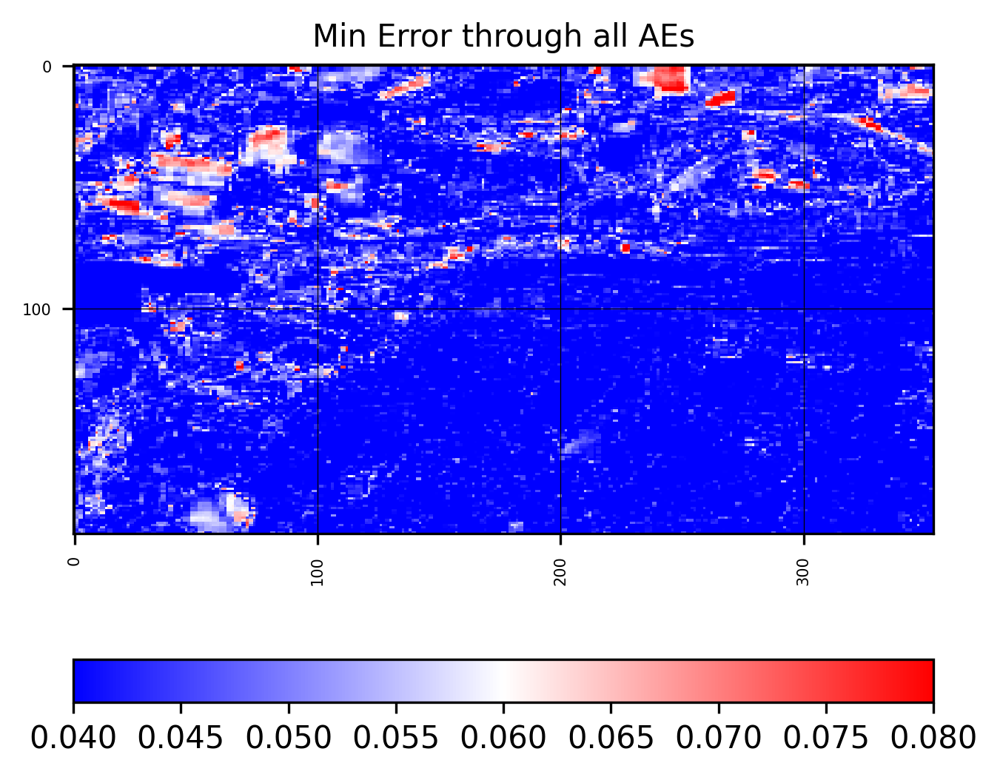

In [67]:
## Min Error of All Autoencoders
print(f'''-------------------------------------------------------------------------------------------
                                        MINIMUM VALUE OF ERRORS
    ------------------------------------------------------------------------------------------------------''')
error = error_list.min(axis=0)
# Plot min error
fig, ax = plt.subplots(figsize=(5,5), dpi=300)
ax = plt.imshow(error, cmap='bwr', interpolation = 'nearest',vmin=vmin, vmax=vmax)
plt.xticks(np.arange(error.shape[1]+1, step=100), fontsize=5, rotation=90)
plt.yticks(np.arange(error.shape[0]+1, step=100), fontsize=5, rotation=0)
plt.grid(color='black', linewidth=0.3)
plt.title(f'Min Error through all AEs', fontsize=10)
fig.colorbar(ax, orientation='horizontal')
plt.savefig(f'{mf3}/min_error.png', format='png', dpi=300)
plt.show()

**REPRESENT MIN ERROR BOUNDING CLUSTERS**

<Figure size 432x288 with 0 Axes>

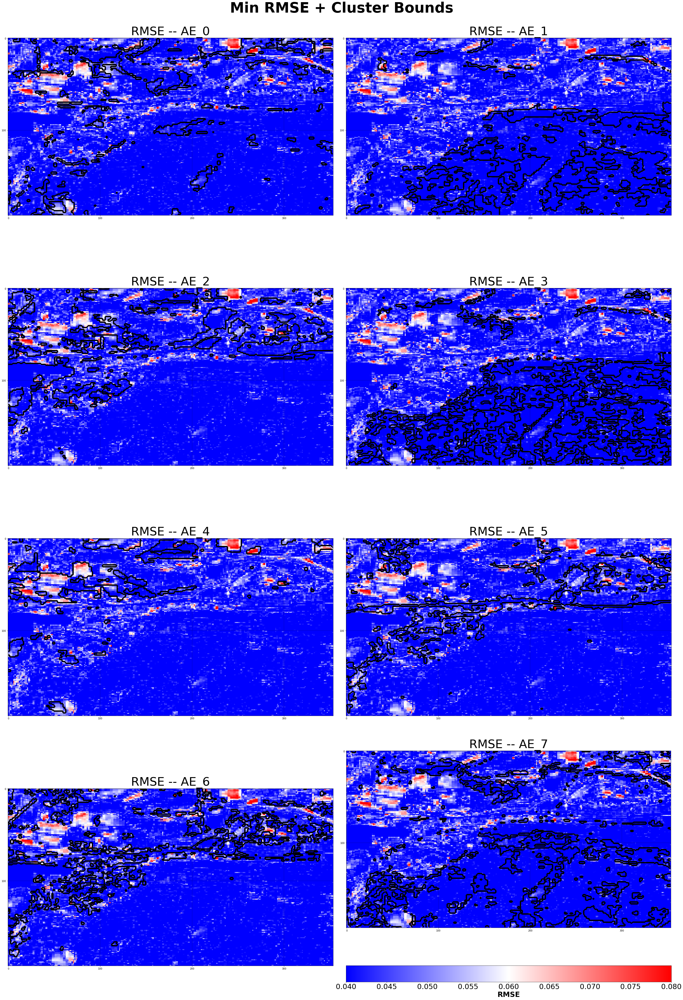

In [68]:
plt.figure()
# Prepare subplots
n_figures = n_clusters
n_rows = 4 
n_cols = 2
rows=[]
columns = []
for row in range(n_rows):
    for col in range(n_cols):
        rows.append(row)
        columns.append(col)

# Subplots and figure title
fig, axs = plt.subplots(n_rows, n_cols, figsize= (40,60))
fig.suptitle(f'Min RMSE + Cluster Bounds', fontsize = 60, fontweight="bold")

# RMSE in each subplot: plot error matrices
cm = 'jet'
for sp in range(n_figures):
    cluster = labels==sp
    ax = axs[rows[sp], columns[sp]]
    im = ax.imshow(error, cmap='bwr', interpolation = 'nearest',vmin=vmin, vmax=vmax)
    ax.contour(cluster, colors='black', linewidths=2)
    ax.set_xticks(np.arange(error.shape[1]+1, step=100))
    ax.set_yticks(np.arange(error.shape[0]+1, step=100))
    ax.grid(color='black', linewidth=0.3)
    ax.set_title(f'RMSE -- AE_{sp}', fontsize=50)

# delete empty figures
for image in range(n_figures, n_rows*n_cols):
    axs[rows[image], columns[image]].set_axis_off()

# colorbar
cb = plt.colorbar(im, orientation="horizontal", pad=0.15)
cb.set_label(label='RMSE', size=30, weight='bold')
cb.ax.tick_params(labelsize=30)

# save
fig.subplots_adjust(top=0.9)
plt.tight_layout()
plt.savefig(f'{mf3}/minRMSE_ClusterBounds.png', format='png', dpi=300)
plt.show()

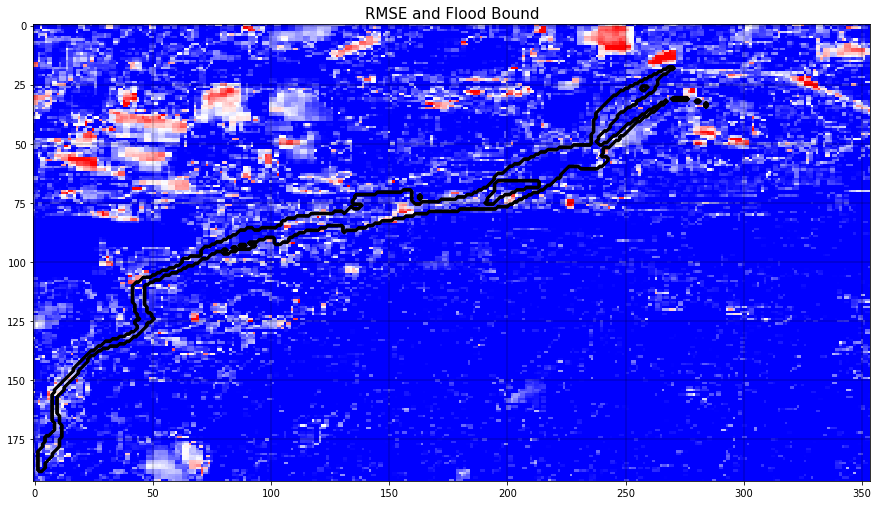

In [70]:
plt.figure(figsize = (15,15))

files = sorted(os.listdir(path_images))
for f in files:
    if not f.startswith(('.','Strobler', 'Test')) and f.endswith(('.tif')) and os.path.isfile(os.path.join(path_images, f)):
        # Labels
        flood = gdal_array.LoadFile(path_images+f)

error = error_list.min(axis=0)
plt.imshow(error, cmap='bwr', interpolation = 'nearest',vmin=vmin, vmax=vmax)
plt.contour(flood==1, colors='black', linewidths=1.5)
plt.grid(color='black', linewidth=0.3)
plt.title(f'RMSE and Flood Bound', fontsize=15)
#fig.colorbar(ax, orientation='horizontal')
plt.savefig(f'{mf3}/minError_FloodBound.png', format='png', dpi=300)
plt.show()

# Reconstruction

**AUTOENCODERS**

In [71]:
# Autoencoder of each pixel
for y in range(testArray.shape[1]):
    for x in range(testArray.shape[2]):
        for c in range(n_clusters):
            if error[y,x] == error_list[c, y, x]:
                error[y,x] = c
            else:
                pass

<Figure size 432x288 with 0 Axes>

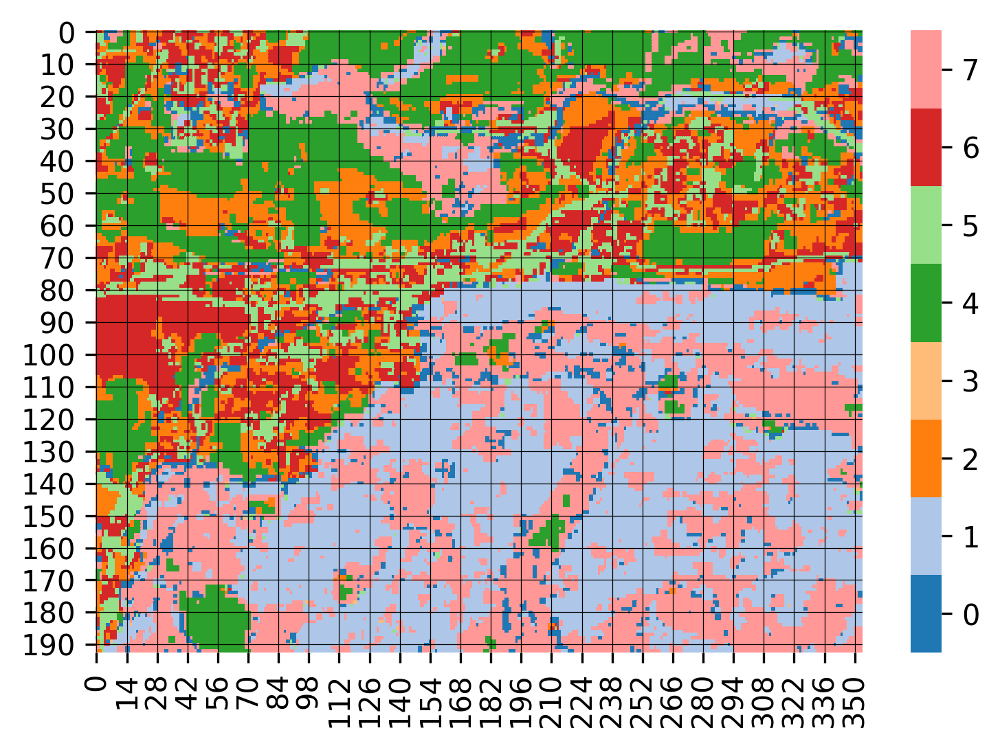

In [72]:
plt.figure()

# discrete colormap (n samples from a given cmap)
cmap = sns.color_palette('tab20', n_clusters) 
fig, ax = plt.subplots(dpi=300) 
ax = sns.heatmap(error, cmap=cmap) 

# modify colorbar:
colorbar = ax.collections[0].colorbar 
r = colorbar.vmax - colorbar.vmin 
colorbar.set_ticks([colorbar.vmin + r / n_clusters * (0.5 + i) for i in range(n_clusters)])
colorbar.set_ticklabels(list(range(n_clusters)))
plt.grid(color='black', linewidth=0.3)

#save and plot
plt.savefig(f'{figures_filepath}/Clusters_Autoencoders.png', format='png', dpi=300)
plt.show()

**TRUE COLOR COMPOSITE**

In [73]:
best_pred = []
for c in range(n_clusters):
    cluster = error == c
    predicted = predictions[c]
    pred_cluster = cluster * predicted
    best_pred.append(pred_cluster)
best_pred = np.array(best_pred)
best_pred = np.sum(best_pred, axis = 0)
best_pred.shape

(14, 193, 354)

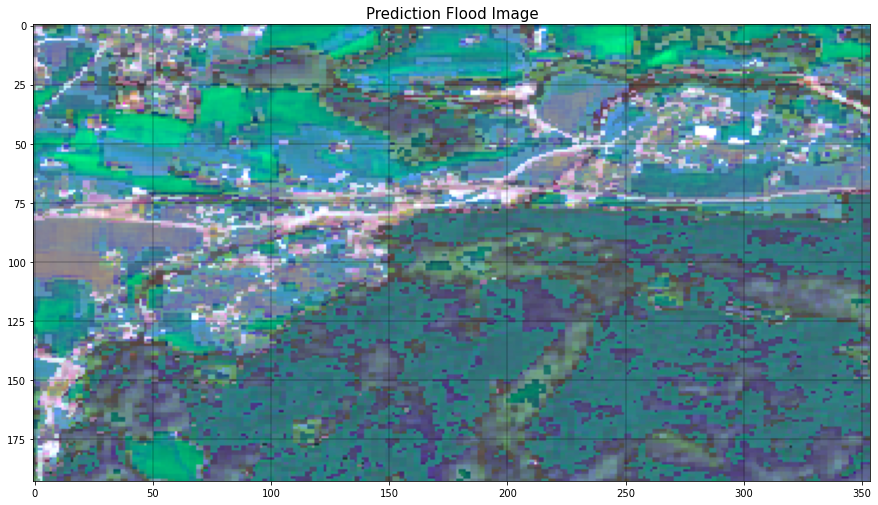

In [74]:
plt.figure(figsize = (15,15))
image = best_pred
img = np.dstack((image[3, ...]*4, image[2, ...]*4, image[1, ...]*4))
img = np.clip(img, 0, 1)
plt.imshow(np.array(img))
plt.grid(color='black', linewidth=0.3)
plt.title(f'Prediction Flood Image', fontsize=15)
plt.savefig(f'{figures_filepath}/reconstruction_TCC.png', format='png', dpi=300)
plt.show()

# Export to tif

In [42]:
np.savetxt("foo.csv", error, delimiter=",")

In [43]:
def write_tiff(m, tifsrc, path_out, name):
    rows = tifsrc.RasterXSize
    cols = tifsrc.RasterYSize
    prj_wkt = tifsrc.GetProjectionRef()
    geotransform = tifsrc.GetGeoTransform()
    driver = gdal.GetDriverByName('GTiff')
    ds = driver.Create(path_out.format(name), rows, cols, 1, gdal.GDT_Float32)
    ds.SetGeoTransform(geotransform)
    ds.SetProjection(prj_wkt)
    outband=ds.GetRasterBand(1)
    outband.WriteArray(m)
    ds = None
    outband = None
'''m=matriz de datos,
tifsrc = objeto tiff generado por gdal (gdal.Open),
path_out = ruta de la carpeta donde lo quieres guardar,
name = nombre del archivo (has de incluirle la extension .tif)'''

'm=matriz de datos,\ntifsrc = objeto tiff generado por gdal (gdal.Open),\npath_out = ruta de la carpeta donde lo quieres guardar,\nname = nombre del archivo (has de incluirle la extension .tif)'

In [44]:
mask_tif='/Users/clara/Desktop/pr.tif'
tifsrc = gdal.Open(mask_tif)

In [45]:
write_tiff(error, tifsrc, '/Users/clara/Desktop/', 'error.tif')

AttributeError: 'NoneType' object has no attribute 'RasterXSize'

In [ ]:
#def write_tiff(m, tifsrc, path_out, name):

rows = tifsrc.RasterXSize
cols = tifsrc.RasterYSize

'''m=matriz de datos,
tifsrc = objeto tiff generado por gdal (gdal.Open),
path_out = ruta de la carpeta donde lo quieres guardar,
name = nombre del archivo (has de incluirle la extension .tif)'''

In [ ]:
prj_wkt = tifsrc.GetProjectionRef()


In [ ]:
geotransform = tifsrc.GetGeoTransform()


In [ ]:
driver = gdal.GetDriverByName('GTiff')


In [ ]:
path_out = '/Users/clara/Desktop/'
name = 'error.tif'
path_out.format(name)

In [ ]:
ds = driver.Create('/Users/clara/Desktop/error.tif', rows, cols, 1, gdal.GDT_Float32)
print(ds)

In [ ]:
ds.SetGeoTransform(geotransform)


In [ ]:
ds.SetProjection(prj_wkt)
outband=ds.GetRasterBand(1)
outband.WriteArray(error)
ds = None
outband = None

# End :)